# PPCD IDA rev2 - Now with logarithmic priors
### Patrick VanMeter
### August 2020

In [2]:
import time
import os
import numpy as np
import scipy as sp
import pandas as pd
from tqdm import tqdm
from importlib import reload
from mst_ida.utilities.graphics import *

## Introduction & Setup

This notebook is intended to be laregely the same as the revised PPCD analysis, but with logarithmic priors over the ion densities. We will define $n_{Z,0} = 10^{X_Z}$ m$^{-3}$ and $\Delta n_Z = 10^{Y_Z}$ m$^{-3}$, where

$$
\begin{align}
    X_Z &\sim \mathcal{U}(14,18) \\
    Y_Z &\sim \mathcal{U}(14,18)
\end{align}
$$

and as before the profile is defined as

$$
    n_Z(\rho) = \big(1 - \rho^{\alpha_Z} \big)^{\beta_Z} + \Delta n_Z \exp{\bigg[ -\bigg(\frac{\rho - \rho_0}{\sqrt{2} w_\rho} \bigg)^2 \bigg]}.
$$

Otherwise, everything will be the same. I will also more specifically separate the MCMC sampling from the analysis so that it is simpler to make modifications later.

Note that the shot being examined is a 300 kA high-performance PPCD discharge. So intuitions about the correct values may be somewhat off.

In [3]:
shot = 1191204050
frame = 9
time_ms = 18.5
exclude = [20, 59, 60, 22, 62, 19]
n2_filters = ['AlBe', 'ZrMylar', 'SiBe']

Load all the data.

In [4]:
import mst_ida.models.base.flux_maps as fm
import mst_ida.data.mesxr as mesxr
import mst_ida.data.thomson as ts
from mst_ida.data.sxt import load_brightness, invert_brightness, filter_list
import mst_ida.data.nickal2 as n2

# MSTfit reconstruction
flux = fm.MSTfit_Flux(shot=shot, frame=frame)

# ME-SXR data
mesxr_data, mesxr_sigmas, p_avgs, thresholds = mesxr.get_smooth_data(shot, frame, center=False)
y_mesxr_data = np.concatenate([mesxr_data[Ec] for Ec in thresholds])
y_mesxr_sigma = np.concatenate([mesxr_sigmas[Ec] for Ec in thresholds])
y_mesxr_ps = np.concatenate([p_avgs for Ec in thresholds])
x_mesxr = np.arange(len(y_mesxr_data))
y_mesxr_labels = np.concatenate([[Ec]*len(mesxr_data[Ec]) for Ec in thresholds])

# Thomson data
ts_data, ts_err, ts_time, ts_radius, ts_flags = ts.get_clean_Te(shot, upper_Te=1400)
tn_ts = np.argmin(np.abs(ts_time - time_ms))+1
y_ts_data = ts_data[tn_ts]
y_ts_sigma = ts_err[tn_ts]
x_ts = ts_radius[tn_ts]

# SXT data
st = load_brightness(shot, t_start=10.0, t_end=25.0, delta=0.5, smooth=10, exclude=exclude)
st.bright['D thick'] *= 10            # Correct gain error
st.sigma['D thick'] *= 10             # Correct gain error
filters = filter_list('all')
tn_sxt = np.argmin(np.abs(st.time - time_ms))
y_sxt_data = np.concatenate([st.bright[f][:,tn_sxt] for f in filters])
y_sxt_sigma = np.concatenate([st.sigma[f][:,tn_sxt] for f in filters])
x_sxt = np.array([n for n in range(1,81) if n not in exclude])
#y_sxt_data[y_sxt_data < 0.5] = 0.0    # Zero out edge channels for a smooth reconstruction

# NICKAl2 data
st_n2 = n2.load_brightness(shot, t_start=10.0, t_end=25.0, delta=0.5, smooth=10)
tn_n2 = np.argmin(np.abs(st_n2.time - time_ms))
y_n2_data = np.array([st_n2.bright[f][tn_n2] for f in n2_filters])
y_n2_sigma = np.array([st_n2.sigma[f][tn_n2] for f in n2_filters])

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1191204050
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1191204050
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Mon Aug 24 16:29:54 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=3.0088351 s
% Compiled module: NICKAL2_SIGNAL.
% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1191204050
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in Volt
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1191204050
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Mon Aug 24 16:29:57 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling br

## Load in the models

In [160]:
from mst_ida.models.plasma import get_avg_Z

# Shared model parameters
avg_Z = get_avg_Z()
ions = ['Al', 'C', 'N', 'B', 'O']
n0_params = np.array([2.0, 10.0, 450.0, 0.6])
n_rs = 500

# Shared model profiles
def temp_prof(rs, Te0, alpha, beta):
    return Te0 * ( 1 - rs**alpha )**beta

def ne_prof(rs, ne0, alpha, beta):
    return ne0 * ( 1 - rs**alpha )**beta

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

def nZ_prof(rs, nZ0, alpha, beta, dnZ, peak_r, width_r):
    return nZ0*( 1 - rs**alpha )**beta + dnZ * np.exp(-(peak_r - rs)**2 / (2*width_r**2))

def get_nZ_profs(rs, nAl0, nC0, alpha, beta, dnAl, dnC, peak_r, width_r):
    nZ0 = {'Al':nAl0, 'C':nC0, 'N':0.3*nC0, 'B':0.3*nC0, 'O':0.9*nC0}
    dnZ = {'Al':dnAl, 'C':dnC, 'N':0.3*dnC, 'B':0.3*dnC, 'O':0.75*dnC}
    return {ion:nZ_prof(rs, nZ0[ion], alpha, beta, dnZ[ion], peak_r, width_r) for ion in ions}

# Default profile parameters
_Te0 = 1100.
_alpha_Te = 7.0
_beta_Te = 7.0
_nAl0 = 2.0e-3
_nC0 = 6.8e-3
_alpha_Z = 12.0
_beta_Z = 4.0
_dnAl = 2.5e-3
_dnC = 1.8e-2
_peak_r = 0.33/0.52
_width_r = 0.09

_XAl = 16.5
_XC = 16.83
_YAl = 16.2
_YC = 17.2

# Default parameter vector
x0 = np.array([_Te0, _alpha_Te, _nAl0, _nC0, _dnAl, _dnC])

In [144]:
import mst_ida.models.mesxr3 as m3

# Create the detector object
p3det = m3.MESXR_Avg(shot=shot, pfm=True, mode='lowE')
n_chords_mesxr = len(p3det.los)

# Make the rhos matrix for "average" chords
Xs_mesxr = np.zeros([n_rs, n_chords_mesxr])
xl = np.zeros([n_rs, n_chords_mesxr])
yl = np.zeros([n_rs, n_chords_mesxr])

for jj, los in enumerate(p3det.los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl[:,jj], yl[:,jj] = los.get_xy(ells)
    Xs_mesxr[:, jj] = ells
    
Rhos_mesxr = flux.rho(xl, yl)

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos_mesxr[Rhos_mesxr < 0] = 0.0
Rhos_mesxr[Rhos_mesxr > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx_mesxr = np.ones(Xs_mesxr.shape)
Dx_mesxr[0,:] = Dx_mesxr[-1,:] = 0.5
for j in range(n_chords_mesxr):
    Dx_mesxr[:,j] *= Xs_mesxr[1,j] - Xs_mesxr[0,j]

# ME-SXR model
def get_emiss_mesxr(Rhos, theta, thresholds=p3det.thresholds):
    Te0, alpha_Te, nAl0, nC0, dnAl, dnC = theta
    Te_params = np.array([Te0, alpha_Te, _beta_Te])
    nZ_params = np.array([nAl0, nC0, _alpha_Z, _beta_Z, dnAl, dnC, _peak_r, _width_r])
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = flux.dens_rho(Rhos) / 1e19
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {Ec:np.zeros(Rhos.shape) for Ec in thresholds}
    for Ec in thresholds:
        emiss_rs[Ec] = ne_rs * nD_rs * np.reshape(p3det.emiss['D'][Ec](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[Ec] += ne_rs * nZ_rs[ion] * np.reshape(p3det.emiss[ion][Ec](pts), Rhos.shape)

        emiss_rs[Ec] *= 1e19 * 1e19 / 2.0
    
    return emiss_rs

def get_model_mesxr(theta, delta_t=0.001, thresholds=p3det.thresholds):
    emiss_rs = get_emiss_mesxr(Rhos_mesxr, theta, thresholds=thresholds)
    return np.concatenate([np.sum(emiss_rs[Ec] * Dx_mesxr, axis=0)*p3det.etendue[Ec] for Ec in thresholds]) * delta_t

In [109]:
from mst_ida.models.sxt import SXT

# Make the detector object
sxt_model = SXT(exclude=exclude)
sxt_los = np.concatenate([sxt_model.los[f] for f in filter_list('thin')])
sxt_ps = np.concatenate([sxt_model.p[f] for f in filter_list('thin')])
labels = np.concatenate([[f]*len(sxt_model.los[f]) for f in filters])
n_chords_sxt = len(sxt_los)

# Make the rhos matrix for "average" chords
Xs_sxt = np.zeros([n_rs, n_chords_sxt])
xl = np.zeros([n_rs, n_chords_sxt])
yl = np.zeros([n_rs, n_chords_sxt])

for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl[:,jj], yl[:,jj] = los.get_xy(ells)
    Xs_sxt[:, jj] = ells
    
Rhos_sxt = flux.rho(xl, yl)

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos_sxt[Rhos_sxt < 0] = 0.0
Rhos_sxt[Rhos_sxt > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx_sxt = np.ones(Xs_sxt.shape)
Dx_sxt[0,:] = Dx_sxt[-1,:] = 0.5
for j in range(n_chords_sxt):
    Dx_sxt[:,j] *= Xs_sxt[1,j] - Xs_sxt[0,j]

# SXT model
def get_emiss_sxt(Rhos, theta):
    Te0, alpha_Te, nAl0, nC0, dnAl, dnC = theta
    Te_params = np.array([Te0, alpha_Te, _beta_Te])
    nZ_params = np.array([nAl0, nC0, _alpha_Z, _beta_Z, dnAl, dnC, _peak_r, _width_r])
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = flux.dens_rho(Rhos) / 1e19
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in ['thick', 'thin']}
    for filt in ['thick', 'thin']:
        emiss_rs[filt] = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)

        emiss_rs[filt] *= 1e19 * 1e19
    
    return emiss_rs

def get_model_sxt(theta):
    emiss_rs = get_emiss_sxt(Rhos_sxt, theta)
    return np.concatenate([np.sum(emiss_rs[filt] * Dx_sxt, axis=0) for filt in ['thick', 'thin']])

In [82]:
from mst_ida.models.nickal2 import NICKAL2

# NICKAl2 model
n2_model = NICKAL2(filters=n2_filters)

# Make the rhos matrix for "average" chords
a = n2_model.los.intercept_with_circle(0.52)
ells = np.linspace(-a, a, num=n_rs)
xl, yl = n2_model.los.get_xy(ells)

Xs_n2 = ells
Rhos_n2 = flux.rho(xl, yl)

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos_n2[Rhos_n2 < 0] = 0.0
Rhos_n2[Rhos_n2 > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx_n2 = np.ones(Xs_n2.shape) * (Xs_n2[1] - Xs_n2[0])
Dx_n2[0] *= 0.5
Dx_n2[-1] *= 0.5

# N2 model
def get_emiss_n2(Rhos, theta):
    Te0, alpha_Te, nAl0, nC0, dnAl, dnC = theta
    Te_params = np.array([Te0, alpha_Te, _beta_Te])
    nZ_params = np.array([nAl0, nC0, _alpha_Z, _beta_Z, dnAl, dnC, _peak_r, _width_r])
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = flux.dens_rho(Rhos) / 1e19
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs, ne_rs, n0_rs ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:avg_Z[ion](pts) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in n2_filters}
    for filt in n2_filters:
        emiss_rs[filt] = ne_rs * nD_rs * n2_model.emiss['D'][filt](pts)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * n2_model.emiss[ion][filt](pts)

        emiss_rs[filt] *= 1e19 * 1e19
    
    return emiss_rs

def get_model_n2(theta):
    emiss_rs = get_emiss_n2(Rhos_n2, theta)
    return np.array([np.sum(emiss_rs[filt] * Dx_n2) for filt in n2_filters])

In [83]:
ts_rhos = np.array([flux.rho(0,y) for y in x_ts*0.52])

def get_model_ts(Te0, alpha, beta):
    return temp_prof(ts_rhos, Te0, alpha, beta)

Plot the models and data at the initial point in the parameter space.

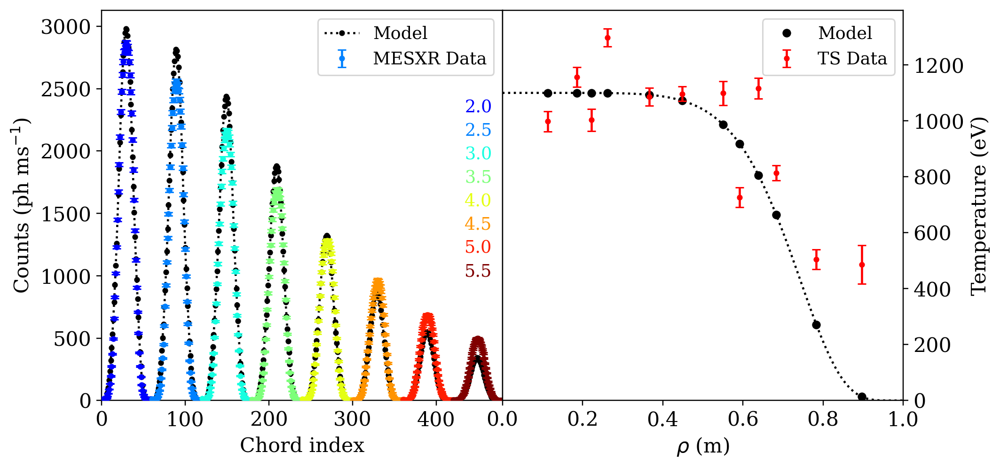

In [110]:
norm = Normalize(1.5, 5.5)

# Load the MLE models
y_mesxr_model = get_model_mesxr(x0)
temp_params = [x0[0], x0[1], _beta_Te]
y_model_ts = get_model_ts(*temp_params)

fig, axs = plt.subplots(1, 2, figsize=(10,5))

# ME-SXR
ii, = np.where(y_mesxr_labels == 2.5)
axs[0].errorbar(x_mesxr[ii], y_mesxr_data[ii], yerr=y_mesxr_sigma[ii], color=cm.jet(norm(2.5)), marker='o', ms=3, capsize=3, linestyle='none', label='MESXR Data')

for index,Ec in enumerate(thresholds):
    ii, = np.where(y_mesxr_labels == Ec)
    axs[0].errorbar(x_mesxr[ii], y_mesxr_data[ii], yerr=y_mesxr_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', zorder=100, color=cm.jet(norm(Ec)))
    text(0.94, 0.75-0.06*index, '{0:.1f}'.format(Ec), axs[0], color=cm.jet(norm(Ec)), fontsize=12)

axs[0].plot(x_mesxr, y_mesxr_model, ':o', ms=3, color='black', label='Model')
axs[0].set_xlim([0, 479])
axs[0].set_xlabel('Chord index')
axs[0].set_ylabel(r'Counts (ph ms$^{-1}$)')

# TS
axs[1].errorbar(ts_rhos, ts_data[tn_ts], yerr=ts_err[tn_ts], marker='o', color='red', ms=3, capsize=3, linestyle='None', zorder=100, label='TS Data')
axs[1].plot(ts_rhos, y_model_ts, label='Model', marker='o', ms=5, color='black', linestyle='none')
axs[1].set_xlabel(r'$\rho$ (m)')
axs[1].set_ylabel(r'Temperature (eV)')
axs[1].set_xlim([0, 1])
axs[1].yaxis.set_label_position("right")
axs[1].yaxis.tick_right()

# Overplot Te prof
rs = np.linspace(0, 1, num=100)
axs[1].plot(rs, temp_prof(rs, *temp_params), color='black', linestyle=':')

for ax in axs:
    ax.legend()
    ax.set_ylim([0,None])
    
plt.subplots_adjust(wspace=0, hspace=0);

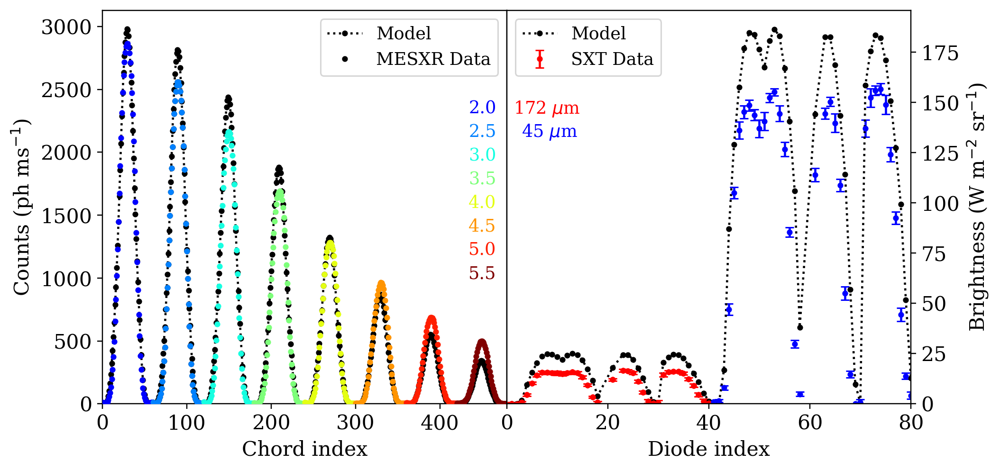

In [111]:
# Load the MLE models
y_mesxr_model = get_model_mesxr(x0)
y_sxt_model = get_model_sxt(x0)

fig, axs = plt.subplots(1, 2, figsize=(10,5))

# ME-SXR
ii, = np.where(y_mesxr_labels == 2.5)
axs[0].errorbar(x_mesxr[ii], y_mesxr_data[ii], color='black', marker='o', ms=3, capsize=3, linestyle='none', label='MESXR Data')

for jj,Ec in enumerate(thresholds):
    ii, = np.where(y_mesxr_labels == Ec)
    axs[0].plot(x_mesxr[ii], y_mesxr_data[ii], marker='o', ms=3, linestyle='none', zorder=100, color=cm.jet(norm(Ec)))
    text(0.94, 0.75-0.06*jj, '{0:.1f}'.format(Ec), axs[0], color=cm.jet(norm(Ec)), fontsize=12)

axs[0].plot(x_mesxr, y_mesxr_model, ':o', ms=3, color='black', label='Model')
axs[0].set_xlim([0, 479])
axs[0].set_xlabel('Chord index')
axs[0].set_ylabel(r'Counts (ph ms$^{-1}$)')

# SXT
colors = ['red', 'blue']
ii, = np.where([l.split()[-1] == 'thick' for l in labels])
axs[1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[0], label='SXT Data')

str_labels = {'thick':r'172 $\mu$m', 'thin':r' 45 $\mu$m'}
for jj,ft in enumerate(['thick', 'thin']):
    ii, = np.where([l.split()[-1] == ft for l in labels])
    axs[1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[jj])
    text(0.1, 0.75-0.06*jj, str_labels[ft], axs[1], color=colors[jj], fontsize=12)
    
axs[1].plot(x_sxt, y_sxt_model, color='black', linestyle=':', marker='o', ms=3, label='Model')
axs[1].set_xlabel('Diode index')
axs[1].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
axs[1].set_xlim([0, 80])

axs[1].yaxis.set_label_position("right")
axs[1].yaxis.tick_right()

for ax in axs:
    ax.legend()
    ax.set_ylim([0,None])
    
plt.subplots_adjust(wspace=0, hspace=0);

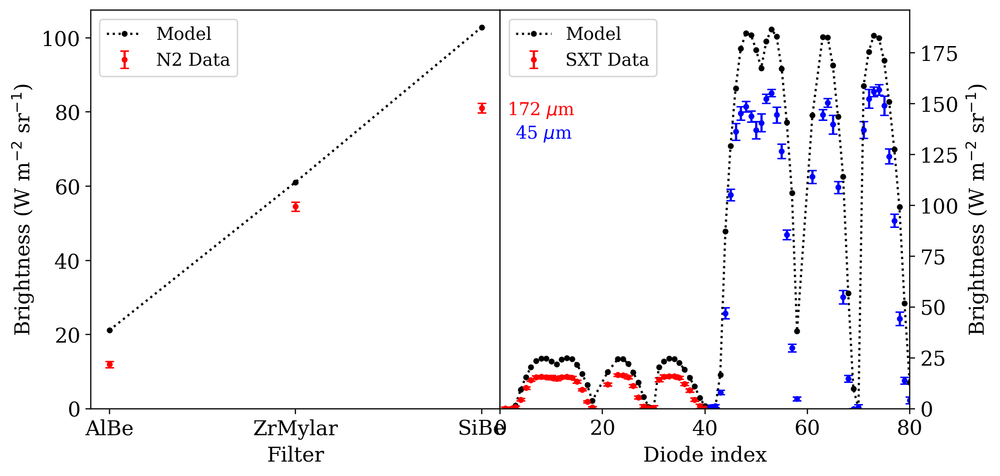

In [112]:
# Load the MLE models
y_n2_model = get_model_n2(x0)
y_sxt_model = get_model_sxt(x0)

fig, axs = plt.subplots(1, 2, figsize=(10,5))

# NICKAl2
axs[0].plot(n2_filters, y_n2_model, marker='o', ms=3, linestyle=':', color='black', label='Model')
axs[0].errorbar(n2_filters, y_n2_data, yerr=y_n2_sigma, marker='o', ms=3, capsize=3, linestyle='none', color='red', label='N2 Data')
axs[0].set_xlabel('Filter')
axs[0].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')

# SXT
colors = ['red', 'blue']
ii, = np.where([l.split()[-1] == 'thick' for l in labels])
axs[1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[0], label='SXT Data')

str_labels = {'thick':r'172 $\mu$m', 'thin':r' 45 $\mu$m'}
for jj,ft in enumerate(['thick', 'thin']):
    ii, = np.where([l.split()[-1] == ft for l in labels])
    axs[1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[jj])
    text(0.1, 0.75-0.06*jj, str_labels[ft], axs[1], color=colors[jj], fontsize=12)
    
axs[1].plot(x_sxt, y_sxt_model, color='black', linestyle=':', marker='o', ms=3, label='Model')
axs[1].set_xlabel('Diode index')
axs[1].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
axs[1].set_xlim([0, 80])

axs[1].yaxis.set_label_position("right")
axs[1].yaxis.tick_right()

for ax in axs:
    ax.legend()
    ax.set_ylim([0,None])
    
plt.subplots_adjust(wspace=0, hspace=0);

Combine into a convenient multi-panel format!

In [408]:
def model_panel_plot(theta):
    y_mesxr_model = get_model_mesxr(theta)
    y_n2_model = get_model_n2(theta)
    y_sxt_model = get_model_sxt(theta)
    temp_params = [theta[0], theta[1], _beta_Te]
    y_model_ts = get_model_ts(*temp_params)

    # Combine all the diagnostic signals
    fig, axs = plt.subplots(2, 2, constrained_layout=True, figsize=(10,8))

    # ME-SXR
    ii, = np.where(y_mesxr_labels == 2.5)
    axs[0,0].errorbar(x_mesxr[ii], y_mesxr_data[ii], yerr=y_mesxr_sigma[ii], color=cm.jet(norm(2.5)),
                      marker='o', ms=3, capsize=3, linestyle='none', label='MESXR Data')

    for index,Ec in enumerate(thresholds):
        ii, = np.where(y_mesxr_labels == Ec)
        axs[0,0].errorbar(x_mesxr[ii], y_mesxr_data[ii], yerr=y_mesxr_sigma[ii], marker='o', ms=3, capsize=3,
                          linestyle='none', zorder=100, color=cm.jet(norm(Ec)))
        text(0.94, 0.75-0.06*index, '{0:.1f}'.format(Ec), axs[0,0], color=cm.jet(norm(Ec)), fontsize=12)

    axs[0,0].plot(x_mesxr, y_mesxr_model, ':o', ms=3, color='black', label='Model')
    axs[0,0].set_xlim([0, 479])
    axs[0,0].set_xlabel('Chord index')
    axs[0,0].set_ylabel(r'Counts (ph ms$^{-1}$)')

    # TS
    axs[0,1].errorbar(ts_rhos, y_ts_data, yerr=y_ts_sigma, marker='o', color='red', ms=3, capsize=3, linestyle='None', zorder=100, label='TS Data')
    axs[0,1].plot(ts_rhos, y_model_ts, label='Model', marker='o', ms=5, color='black', linestyle='none')
    axs[0,1].set_xlabel(r'$\rho$ (m)')
    axs[0,1].set_ylabel(r'Temperature (eV)')
    axs[0,1].set_xlim([0, 1])
    axs[0,1].yaxis.set_label_position("right")
    axs[0,1].yaxis.tick_right()

    rs = np.linspace(0, 1, num=100)
    axs[0,1].plot(rs, temp_prof(rs, *temp_params), color='black', linestyle=':')

    # NICKAl2
    axs[1,0].plot(n2_filters, y_n2_model, marker='o', ms=3, linestyle=':', color='black', label='Model')
    axs[1,0].errorbar(n2_filters, y_n2_data, yerr=y_n2_sigma, marker='o', ms=3, capsize=3, linestyle='none', color='red', label='N2 Data')
    axs[1,0].set_xlabel('Filter')
    axs[1,0].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')

    # SXT
    colors = ['red', 'blue']
    ii, = np.where([l.split()[-1] == 'thick' for l in labels])
    axs[1,1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[0], label='SXT Data')

    str_labels = {'thick':r'172 $\mu$m', 'thin':r' 45 $\mu$m'}
    for jj,ft in enumerate(['thick', 'thin']):
        ii, = np.where([l.split()[-1] == ft for l in labels])
        axs[1,1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[jj])
        text(0.1, 0.75-0.06*jj, str_labels[ft], axs[1,1], color=colors[jj], fontsize=12)

    axs[1,1].plot(x_sxt, y_sxt_model, color='black', linestyle=':', marker='o', ms=3, label='Model')
    axs[1,1].set_xlabel('Diode index')
    axs[1,1].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
    axs[1,1].set_xlim([0, 80])

    axs[1,1].yaxis.set_label_position("right")
    axs[1,1].yaxis.tick_right()

    # Make it look better
    for ax in axs.ravel():
        ax.legend()
        ax.set_ylim([0,None])
        
    return fig, axs

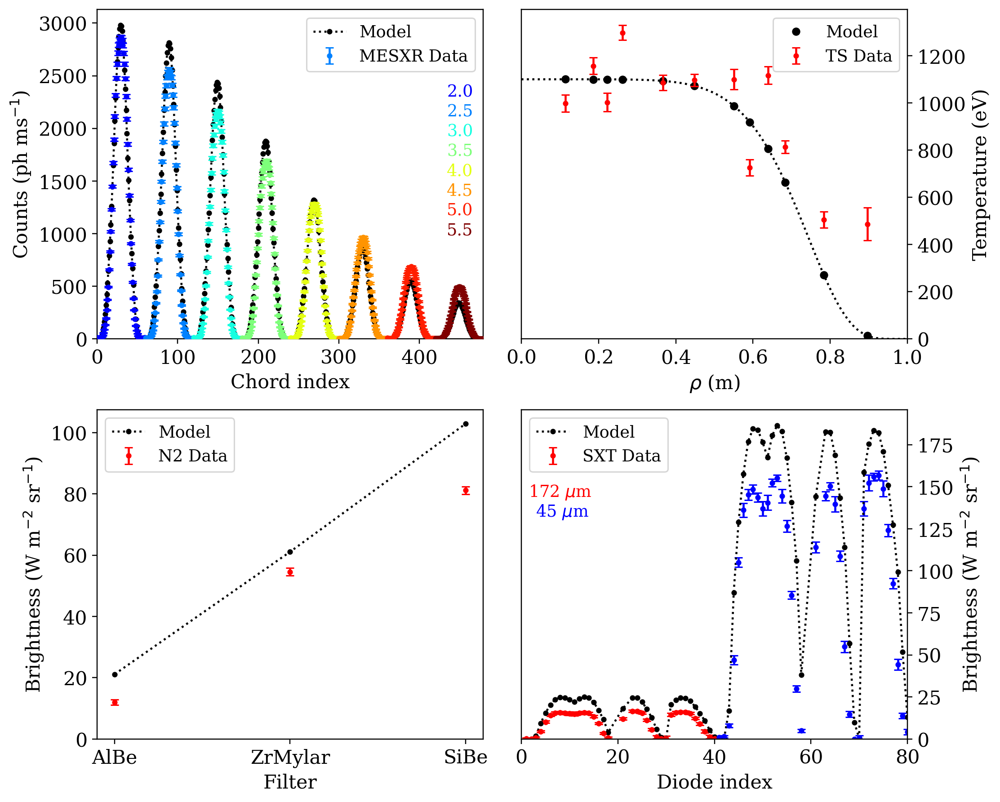

In [114]:
fig, ax = model_panel_plot(x0)

## MLE Calculations

I will perform several variations on this calculation in order to compare the impact of adding new data into the calculation. My analysis will break down into four scenarios:
1. ME-SXR only
2. ME-SXR + TS
3. ME-SXR + SXT + N2
4. ME-SXR + TS + SXT + N2

In [133]:
# ME-SXR likelihood parameters
thresh=[2., 2.5, 3., 3.5, 4.0, 4.5]
ii_mesxr, = np.where([y_mesxr_labels[index] in thresh and np.abs(y_mesxr_ps[index]) <= 0.35 for index in range(len(x_mesxr))])
#ii_mesxr, = np.where([np.abs(y_mesxr_ps[index]) <= 0.35 for index in range(len(x_mesxr))])
#ii_mesxr = np.copy(x_mesxr)

# NICKAl2 likelihood parameters
include_n2 = ['AlBe', 'SiBe']
ii_n2, = np.where([f in include_n2 for f in n2_filters])

# Define the individual likelihoods
def ln_likelihood_mesxr(theta):
    y_model = get_model_mesxr(theta)
    return -0.5*np.sum( (y_mesxr_data[ii_mesxr] - y_model[ii_mesxr])**2 / (y_mesxr_sigma[ii_mesxr]**2 + (0.15*y_model[ii_mesxr])**2) )

def ln_likelihood_sxt(theta):
    y_model = get_model_sxt(theta)
    return -0.5*np.sum( (y_sxt_data - y_model)**2 / (y_sxt_sigma**2 + (0.05*y_model)**2) )

def ln_likelihood_n2(theta):
    y_model = get_model_n2(theta)
    return -0.5*np.sum( (y_n2_data[ii_n2] - y_model[ii_n2])**2 / (y_n2_sigma[ii_n2]**2 + (0.07*y_model[ii_n2])**2) )

def ln_likelihood_ts(theta):
    Te0, alpha_Te, nAl0, nC0, dnAl, dnC = theta
    y_model = get_model_ts(Te0, alpha_Te, _beta_Te)
    return -0.5*np.sum( (y_ts_data - y_model)**2 / y_ts_sigma**2 )

# Define the likelihoods for each scenario
def ln_likelihood_s1(theta):
    return ln_likelihood_mesxr(theta)

def ln_likelihood_s2(theta):
    return ln_likelihood_mesxr(theta) + ln_likelihood_ts(theta)

def ln_likelihood_s3(theta):
    return ln_likelihood_sxt(theta) + ln_likelihood_n2(theta) + ln_likelihood_ts(theta)

def ln_likelihood_s4(theta):
    return ln_likelihood_mesxr(theta) + ln_likelihood_sxt(theta) + ln_likelihood_n2(theta) + ln_likelihood_ts(theta)

In [66]:
%timeit ln_likelihood_s1(x0)

1.32 s ± 10.4 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [16]:
%timeit ln_likelihood_s2(x0)

1.14 s ± 2.47 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [121]:
%timeit ln_likelihood_s3(x0)

299 ms ± 642 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [18]:
%timeit ln_likelihood_s4(x0)

1.44 s ± 8.51 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [416]:
from mst_ida.utilities.functions import get_MLE

# Te0, alpha_Te, nAl0, nC0, dnAl, dnC = theta
# Bounds for MLE estimate - restrict nC0!
bounds = [(0.0, 2000.0),
          (2.0, 14.0),
          (1e-3, 5e-2),
          (1e-3, 5e-2),#(6.7e-3, 6.9e-3),
          (1e-4, 1e-1),
          (1e-4, 1e-1)]

In [417]:
# Maximum likelihood - scanrio 1
theta0_MLE_s1 = get_MLE(ln_likelihood_s1, x0, bounds=bounds)

MLE required 467.73868346214294 seconds.
      fun: 71.55033330496134
 hess_inv: <6x6 LbfgsInvHessProduct with dtype=float64>
      jac: array([-2.48026091e-01,  5.16806111e-02, -2.83187660e+00, -1.45416550e+00,
       -4.93939467e-01,  1.85225879e+03])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 413
      nit: 35
     njev: 59
   status: 0
  success: True
        x: array([1.10053604e+03, 9.47987810e+00, 2.89875649e-03, 5.22745893e-03,
       3.70845275e-03, 1.00000000e-04])


In [418]:
# Maximum likelihood - scanrio 2
theta0_MLE_s2 = get_MLE(ln_likelihood_s2, x0, bounds=bounds)

MLE required 418.84352588653564 seconds.
      fun: 170.8160981828928
 hess_inv: <6x6 LbfgsInvHessProduct with dtype=float64>
      jac: array([-2.18565257e-01,  3.30913936e-02,  1.10904921e+00,  8.49314574e-01,
        6.85471946e-01,  1.47184976e+03])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 371
      nit: 34
     njev: 53
   status: 0
  success: True
        x: array([1.10024996e+03, 8.83936465e+00, 1.25115779e-03, 1.04617894e-02,
       7.85498740e-04, 1.00000000e-04])


In [147]:
# Maximum likelihood - scanrio 3
theta0_MLE_s3 = get_MLE(ln_likelihood_s3, x0, bounds=bounds)

MLE required 76.05160307884216 seconds.
      fun: 534.3283396145193
 hess_inv: <6x6 LbfgsInvHessProduct with dtype=float64>
      jac: array([-2.07799000e-01,  2.08683561e-01, -3.49149332e+00,  3.51872691e+03,
        9.48776048e+04,  3.42656783e+03])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 252
      nit: 29
     njev: 36
   status: 0
  success: True
        x: array([1.09911413e+03, 6.13997590e+00, 1.89585862e-03, 1.00000000e-03,
       1.00000000e-03, 1.00000000e-03])


In [195]:
# Maximum likelihood - scanrio 4
theta0_MLE_s4 = get_MLE(ln_likelihood_s4, x0, bounds=bounds)

MLE required 286.83923411369324 seconds.
      fun: 881.225853596183
 hess_inv: <6x6 LbfgsInvHessProduct with dtype=float64>
      jac: array([-4.47271487e-01,  5.61612982e-01,  1.25709221e+01, -4.71133035e+00,
        1.51418510e+05, -1.51858330e+00])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 203
      nit: 25
     njev: 29
   status: 0
  success: True
        x: array([1.10121724e+03, 7.97683120e+00, 1.40719025e-03, 9.17375492e-03,
       1.00000000e-03, 2.76112596e-03])


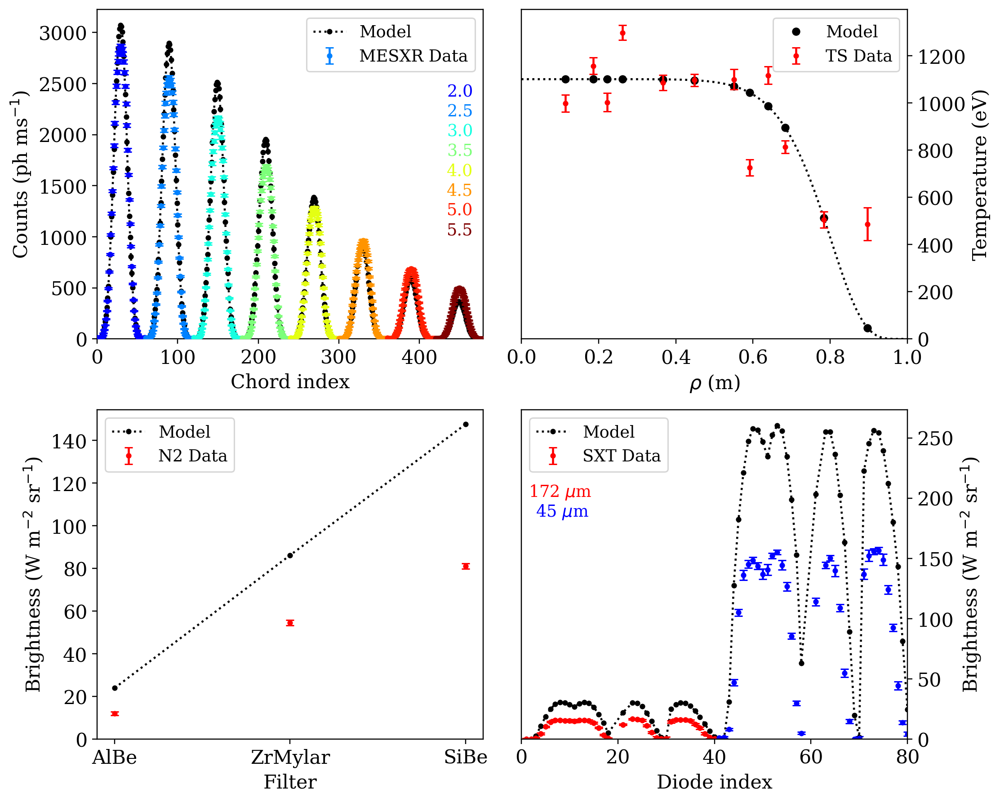

In [414]:
fig, ax = model_panel_plot(theta0_MLE_s1)

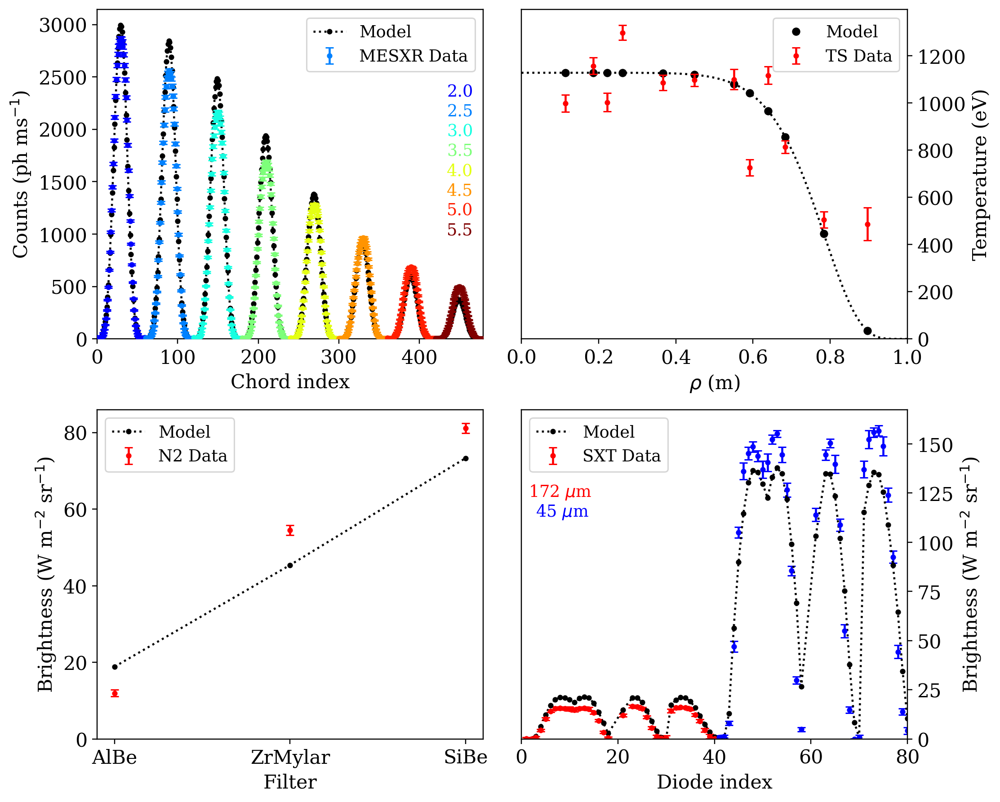

In [411]:
fig, ax = model_panel_plot(theta0_MLE_s2)

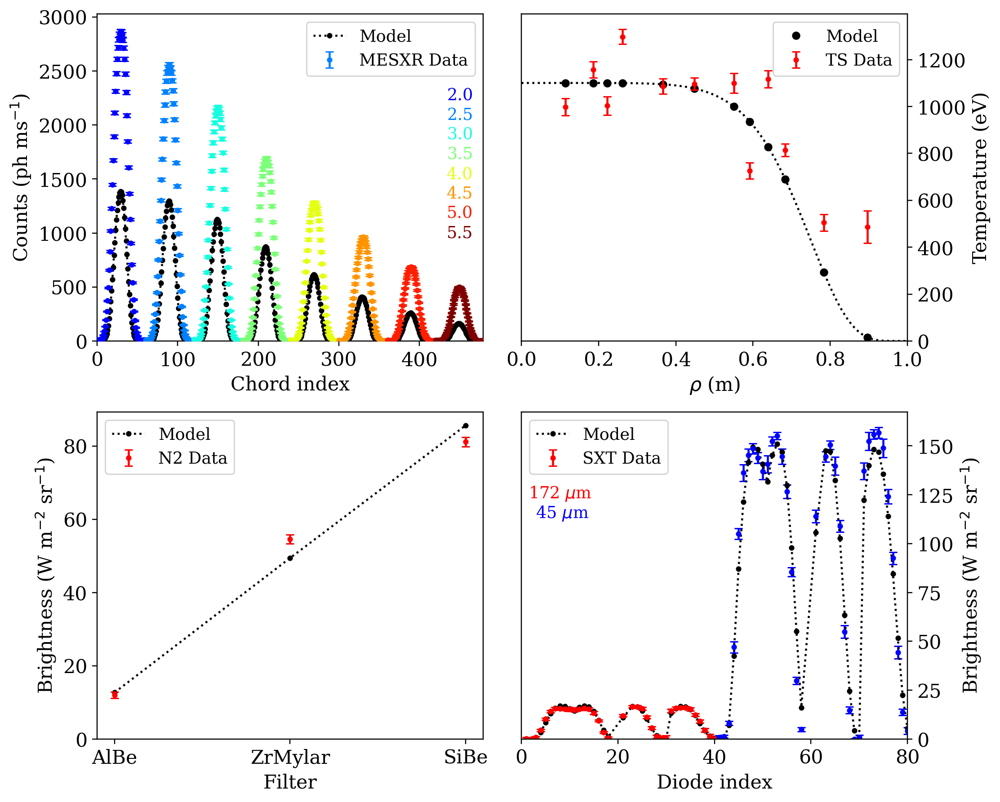

In [132]:
fig, ax = model_panel_plot(theta0_MLE_s3)

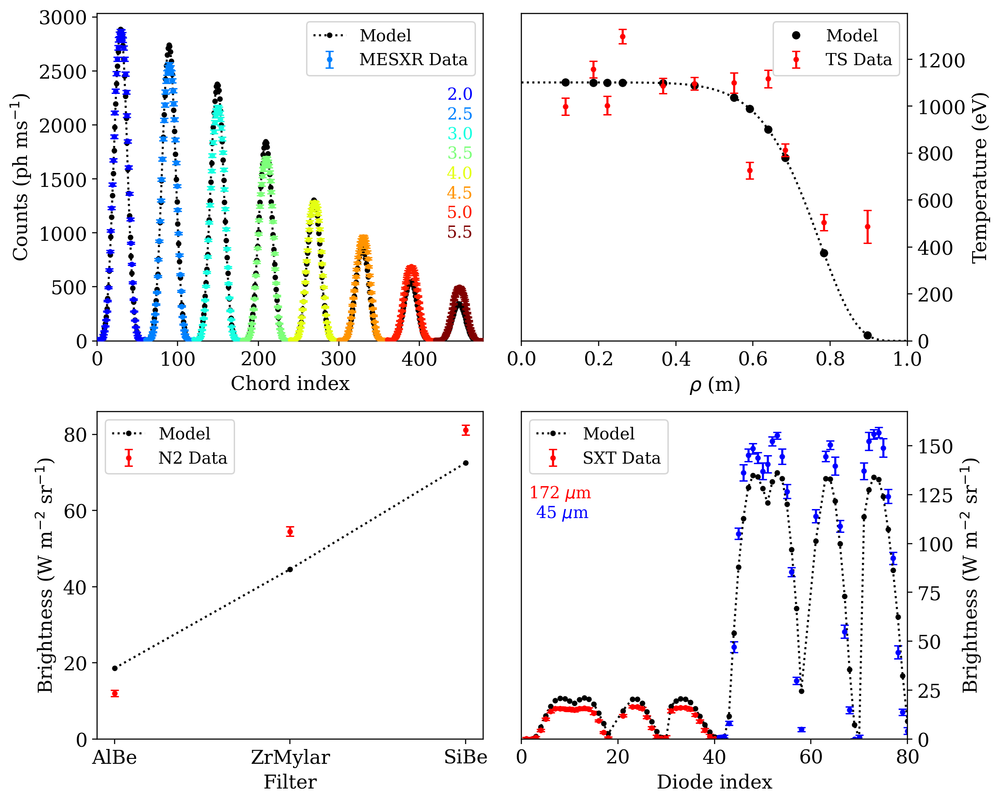

In [197]:
fig, ax = model_panel_plot(theta0_MLE_s4)

## Analysis/Illustration functions

In [148]:
from mst_ida.analysis.ida import profile_confidence
from mst_ida.utilities.structures import AttrDict

def get_prof_samples(samples, num_samples=1000, num_rs=100):
    rs = np.linspace(0,1, num=num_rs)
    prof_samples = AttrDict({
        'Te':np.zeros([num_samples, len(rs)]),
        'nZ':{ion:np.zeros([num_samples, len(rs)]) for ion in ions},
        'nD':np.zeros([num_samples, len(rs)]),
        'Zeff':np.zeros([num_samples, len(rs)])
    })

    ne_rs = flux.dens_rho(rs) / 1e19

    for ii, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
        Te0, alpha_Te, nAl0, nC0, dnAl, dnC = samples[n,:]
        Te_params = np.array([Te0, alpha_Te, _beta_Te])
        nZ_params = np.array([nAl0, nC0, _alpha_Z, _beta_Z, dnAl, dnC, _peak_r, _width_r])

        # Calculate the base plasma parameters
        Te_rs = temp_prof(rs, *Te_params)
        nZ_rs = get_nZ_profs(rs, *nZ_params)
        n0_rs = n0_prof(rs, *n0_params)
        pts = list( zip( Te_rs, ne_rs, n0_rs ) )

        # Get avg_Z and nD
        avg_Z_rs = {ion:avg_Z[ion](pts) for ion in ions}

        nD_rs = np.ones(rs.shape)
        for ion in ions:
            nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
        nD_rs *= ne_rs
        nD_rs[nD_rs < 0] = 0.0

        # Get Zeff
        Zeff_rs = (nD_rs / ne_rs)
        for ion in ions:
            Zeff_rs += ( nZ_rs[ion]/ne_rs ) * avg_Z_rs[ion]**2

        # Store the results
        prof_samples.Te[ii,:] = Te_rs
        prof_samples.nD[ii,:] = nD_rs
        prof_samples.Zeff[ii,:] = Zeff_rs
        for ion in ions:
            prof_samples.nZ[ion][ii,:] = nZ_rs[ion]


    prof_CIs = AttrDict({
        'Te':profile_confidence(prof_samples.Te),
        'nD':profile_confidence(prof_samples.nD),
        'Zeff':profile_confidence(prof_samples.Zeff),
        'nZ':{ion:profile_confidence(prof_samples.nZ[ion]) for ion in ions}
    })
    
    return prof_samples, prof_CIs, rs

In [524]:
def prof_CIs_plot(rs, prof_CIs):
    fig, axs = plt.subplots(5,1, figsize=(8,10))
    props = dict(boxstyle='round', facecolor='white', alpha=0.8)

    # Temperature
    axs[0].plot(rs, prof_CIs.Te['median']/1e3, color='xkcd:orange', zorder=100)
    axs[0].fill_between(rs, prof_CIs.Te['1 sigma']['low']/1e3, prof_CIs.Te['1 sigma']['high']/1e3, color='xkcd:royal blue', zorder=90)
    axs[0].fill_between(rs, prof_CIs.Te['2 sigma']['low']/1e3, prof_CIs.Te['2 sigma']['high']/1e3, color='xkcd:bright blue', zorder=80)
    axs[0].fill_between(rs, prof_CIs.Te['3 sigma']['low']/1e3, prof_CIs.Te['3 sigma']['high']/1e3, color='xkcd:sky blue', zorder=70)
    axs[0].set_ylabel(r'$T_\mathrm{e}$ (keV)')

    # Electron/deuterium density
    ne_rs = flux.dens_rho(rs) / 1e19
    axs[1].plot(rs, ne_rs, label=r'$n_\mathrm{e}$', color='black', linestyle='dashed')
    axs[1].plot(rs, prof_CIs.nD['median'], color='xkcd:orange', zorder=100)
    axs[1].fill_between(rs, prof_CIs.nD['1 sigma']['low'], prof_CIs.nD['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
    axs[1].fill_between(rs, prof_CIs.nD['2 sigma']['low'], prof_CIs.nD['2 sigma']['high'], color='xkcd:bright blue', zorder=80)
    axs[1].fill_between(rs, prof_CIs.nD['3 sigma']['low'], prof_CIs.nD['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
    axs[1].set_ylabel(r'$n_\mathrm{D}$ ($10^{19}$ m$^{-3}$)')
    axs[1].legend()

    # Impurities - ALuminum
    axs[2].plot(rs, prof_CIs.nZ['Al']['median']/1e-3, color='xkcd:orange', zorder=100)
    axs[2].fill_between(rs, prof_CIs.nZ['Al']['1 sigma']['low']/1e-3, prof_CIs.nZ['Al']['1 sigma']['high']/1e-3, color='xkcd:royal blue', zorder=90)
    axs[2].fill_between(rs, prof_CIs.nZ['Al']['2 sigma']['low']/1e-3, prof_CIs.nZ['Al']['2 sigma']['high']/1e-3, color='xkcd:bright blue', zorder=80)
    axs[2].fill_between(rs, prof_CIs.nZ['Al']['3 sigma']['low']/1e-3, prof_CIs.nZ['Al']['3 sigma']['high']/1e-3, color='xkcd:sky blue', zorder=70)
    axs[2].set_ylabel(r'$n_\mathrm{Al}$ ($10^{16}$ m$^{-3}$)')
    #axs[2].set_yscale('log')

    # Impurities - Carbon
    axs[3].plot(rs, prof_CIs.nZ['C']['median']/1e-3, color='xkcd:orange', zorder=100)
    axs[3].fill_between(rs, prof_CIs.nZ['C']['1 sigma']['low']/1e-3, prof_CIs.nZ['C']['1 sigma']['high']/1e-3, color='xkcd:royal blue', zorder=90)
    axs[3].fill_between(rs, prof_CIs.nZ['C']['2 sigma']['low']/1e-3, prof_CIs.nZ['C']['2 sigma']['high']/1e-3, color='xkcd:bright blue', zorder=80)
    axs[3].fill_between(rs, prof_CIs.nZ['C']['3 sigma']['low']/1e-3, prof_CIs.nZ['C']['3 sigma']['high']/1e-3, color='xkcd:sky blue', zorder=70)
    axs[3].set_ylabel(r'$n_\mathrm{C}$ ($10^{16}$ m$^{-3}$)')
    #axs[3].set_yscale('log')

    # Zeff
    axs[4].plot(rs, prof_CIs.Zeff['median'], color='xkcd:orange', zorder=100)
    axs[4].fill_between(rs, prof_CIs.Zeff['1 sigma']['low'], prof_CIs.Zeff['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
    axs[4].fill_between(rs, prof_CIs.Zeff['2 sigma']['low'], prof_CIs.Zeff['2 sigma']['high'], color='xkcd:bright blue', zorder=80)
    axs[4].fill_between(rs, prof_CIs.Zeff['3 sigma']['low'], prof_CIs.Zeff['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
    axs[4].set_ylabel(r'$Z_{eff}$')

    # Make it look good
    for ax in axs:
        ax.set_xlim([0,0.8])
        if ax.get_yscale() != 'log':
            ax.set_ylim([0,None])
            ax.yaxis.set_major_locator(MaxNLocator(nbins=3, prune='upper'))
        else:
            #locator = ticker.LogLocator(base=10)
            ax.yaxis.set_major_locator(LogLocator(base=10, numticks=15))
            ax.set_ylim([5e-4, 8e-2])

    for ax in axs[:-1]:
        ax.xaxis.set_ticklabels([])

    for ax,alpha in zip(axs,['a','b','c','d', 'e']):
        text(0.04, 0.7, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props, zorder=100)

    axs[-1].set_xlabel(r'$\rho$ (norm)')
    plt.subplots_adjust(wspace=0, hspace=0)
    
    return fig, axs

## Illustrate the priors

In [150]:
import emcee

In [323]:
# Galante priors
mu_Al = 2e-3
mu_C = 6.8e-3
sigma_Al = 0.5e-3
sigma_C = 1.4e-3

# Define the priors - same for all scenarios
def ln_prior(theta):
    Te0, alpha_Te, nAl0, nC0, dnAl, dnC = theta
    prior = (0.0 < Te0 < 2000.0) *\
            (2.0 < alpha_Te < 14.0) *\
            (1e-3 < nAl0 < 1e-2) *\
            (1e-3 < nC0  < 5e-2) *\
            (1e-4 < dnAl < 5e-2) *\
            (1e-4 < dnC  < 5e-2)
    if prior:
        return ln_prior_galante_nC(nC0)
    else:
        return -np.inf
    
def ln_prior_galante(nAl0, nC0):
    return -0.5 * ( ((nAl0 - mu_Al) / sigma_Al )**2 + ((nC0 - mu_C) / sigma_C )**2 )

def ln_prior_galante_nC(nC0):
    return -0.5 * ((nC0 - mu_C) / sigma_C )**2

In [320]:
num_samples = 10000
samples_s0 = np.zeros([num_samples, 6])
samples_s0[:,0] = np.random.uniform(low=0.0, high=2000.0, size=num_samples)    # Te0
samples_s0[:,1] = np.random.uniform(low=2.0, high=14.0, size=num_samples)      # alpha_T
samples_s0[:,2] = np.random.uniform(low=1e-3, high=1e-2, size=num_samples)     # nAl0
samples_s0[:,3] = np.random.normal(loc=mu_C, scale=sigma_C, size=num_samples)  # nC0
samples_s0[:,4] = np.random.uniform(low=1e-4, high=5e-2, size=num_samples)     # dnAl
samples_s0[:,5] = np.random.uniform(low=1e-4, high=5e-2, size=num_samples)     # dnC

#samples_s0[:,2] = np.random.normal(loc=mu_Al, scale=sigma_Al, size=num_samples)

In [321]:
prof_samples_s0, prof_CIs_s0, rs = get_prof_samples(samples_s0)

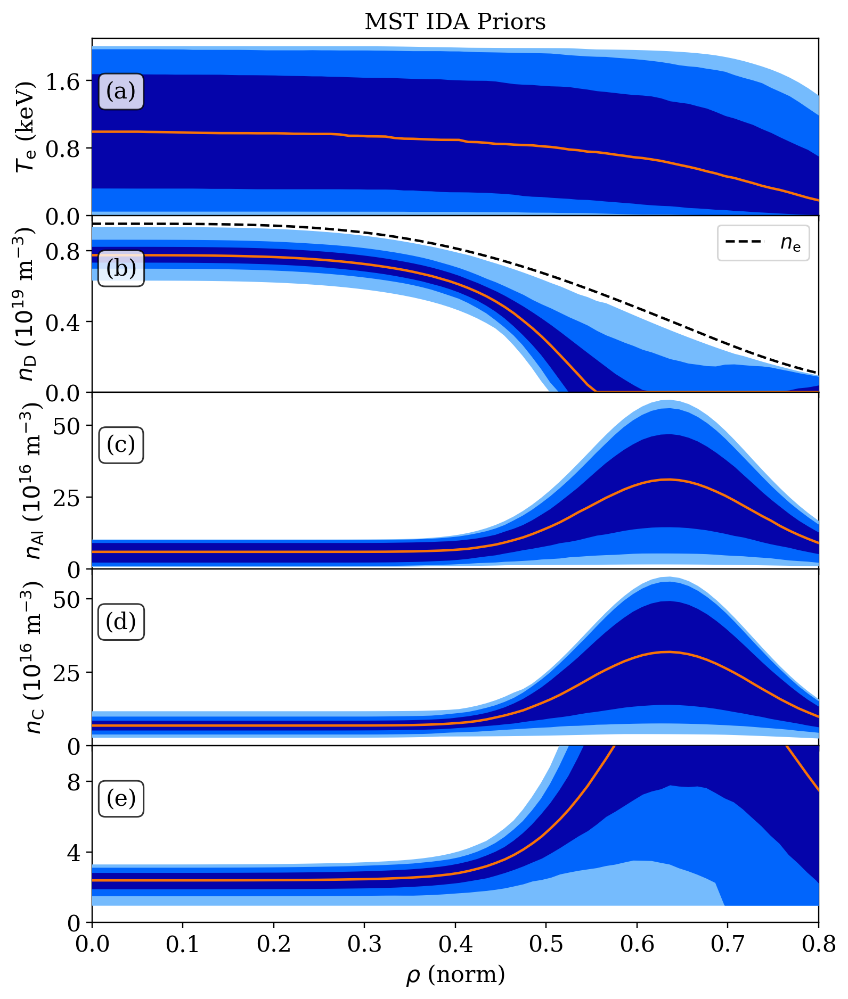

In [322]:
fig, axs = prof_CIs_plot(rs, prof_CIs_s0)
axs[0].set_title('MST IDA Priors', fontsize=14)
axs[-1].set_ylim([0,10]);

## MCMC Sampling

In [291]:
# Define the probability function for each scenario
def ln_prob_s1(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood_s1(theta)
    else:
        return -np.inf
    
def ln_prob_s2(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood_s2(theta)
    else:
        return -np.inf
    
def ln_prob_s3(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood_s3(theta)
    else:
        return -np.inf
    
def ln_prob_s4(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood_s4(theta)
    else:
        return -np.inf

In [292]:
def get_pos0(theta0):
    pos0 = np.zeros([nwalkers, ndim])
    for ii in range(nwalkers):
        pos0[ii,:] = theta0 + 0.05*theta0* np.random.randn(ndim)

        # Ensure all pos0 starting positions are within bounds
        while not np.isfinite(ln_prior(pos0[ii,:])):
            pos0[ii,:] = theta0 + 0.05*theta0* np.random.randn(ndim)
            
    return pos0

In [293]:
import emcee
from multiprocessing import Pool

# General emcee settings
n_steps = 2000
nwalkers = 50
ndim = len(x0)

# Reccommended to avoid errors
os.environ["OMP_NUM_THREADS"] = "1"

# Backends for each case
fdir = '/home/pdvanmeter/data/emcee/ppcd/final_IDA/'
backends = {}
for index in range(1,5):
    filepath = fdir + 'MST_IDA_v3_s{0:}.h5'.format(index)
    backends[index] = emcee.backends.HDFBackend(filepath)
    backends[index].reset(nwalkers, ndim)

In [247]:
pos0 = get_pos0(theta0_MLE_s1)

with Pool(28) as pool:
    sampler_s1 = emcee.EnsembleSampler(nwalkers, ndim, ln_prob_s1, pool=pool, backend=backends[1])
    sampler_s1.run_mcmc(None, 100, progress=True)

100%|██████████| 100/100 [07:48<00:00,  4.69s/it]


In [248]:
pos0 = get_pos0(theta0_MLE_s2)

with Pool(28) as pool:
    sampler_s2 = emcee.EnsembleSampler(nwalkers, ndim, ln_prob_s2, pool=pool, backend=backends[2])
    sampler_s2.run_mcmc(None, 100, progress=True)

100%|██████████| 100/100 [08:24<00:00,  5.05s/it]


In [249]:
pos0 = get_pos0(theta0_MLE_s3)

with Pool(28) as pool:
    sampler_s3 = emcee.EnsembleSampler(nwalkers, ndim, ln_prob_s3, pool=pool, backend=backends[3])
    sampler_s3.run_mcmc(None, 100, progress=True)

100%|██████████| 100/100 [11:03<00:00,  6.64s/it]


In [294]:
pos0 = get_pos0(theta0_MLE_s4)

with Pool(28) as pool:
    sampler_s4 = emcee.EnsembleSampler(nwalkers, ndim, ln_prob_s4, pool=pool, backend=backends[4])
    sampler_s4.run_mcmc(pos0, 2000, progress=True)

100%|██████████| 2000/2000 [3:41:49<00:00,  6.65s/it]  


In [263]:
samplers = {1:sampler_s1, 2:sampler_s2, 3:sampler_s3, 4:sampler_s4}
burn_steps = {1:1000, 2:1000, 3:1000, 4:1500}
outliers = {1:True, 2:True, 3:False, 4:False}

samples = {}
for index in range(1,5):
    samples[index] = samplers[index].get_chain(discard=burn_steps[index], flat=True)
    if outliers[index]:
        samples[index] = identify_outliers(samples[index], param=3)

NameError: name 'sampler_s1' is not defined

In [295]:
samplers = {1:None, 2:None, 3:None, 4:sampler_s4}
samples = {1:None, 2:None, 3:None, 4:sampler_s4.get_chain(discard=1500, flat=True)}

## MCMC Results

In [270]:
import mst_ida.analysis.plots as idap
from mst_ida.utilities.functions import identify_outliers

params = [r'$T_{e,0}$', r'$\alpha$', r'$n_{Al,0}$', r'$n_{C,0}$', r'$\delta n_{Al}$', r'$\delta n_C$']

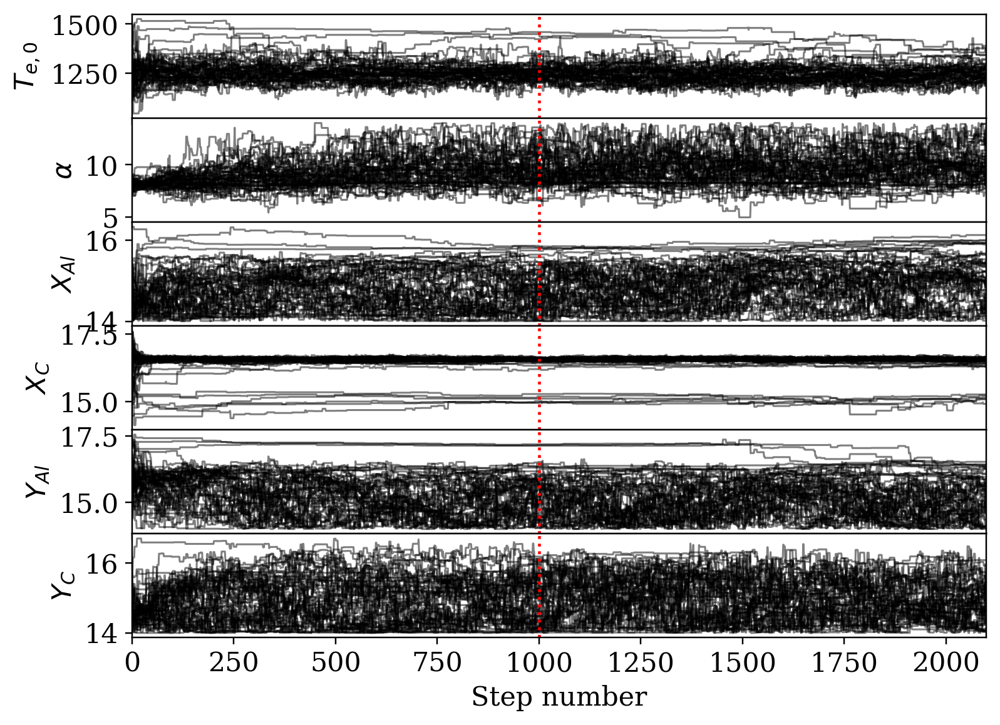

In [327]:
burn_step = 1000
fig, ax = idap.burn_plot(samplers[1].chain, burn_steps[1], nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

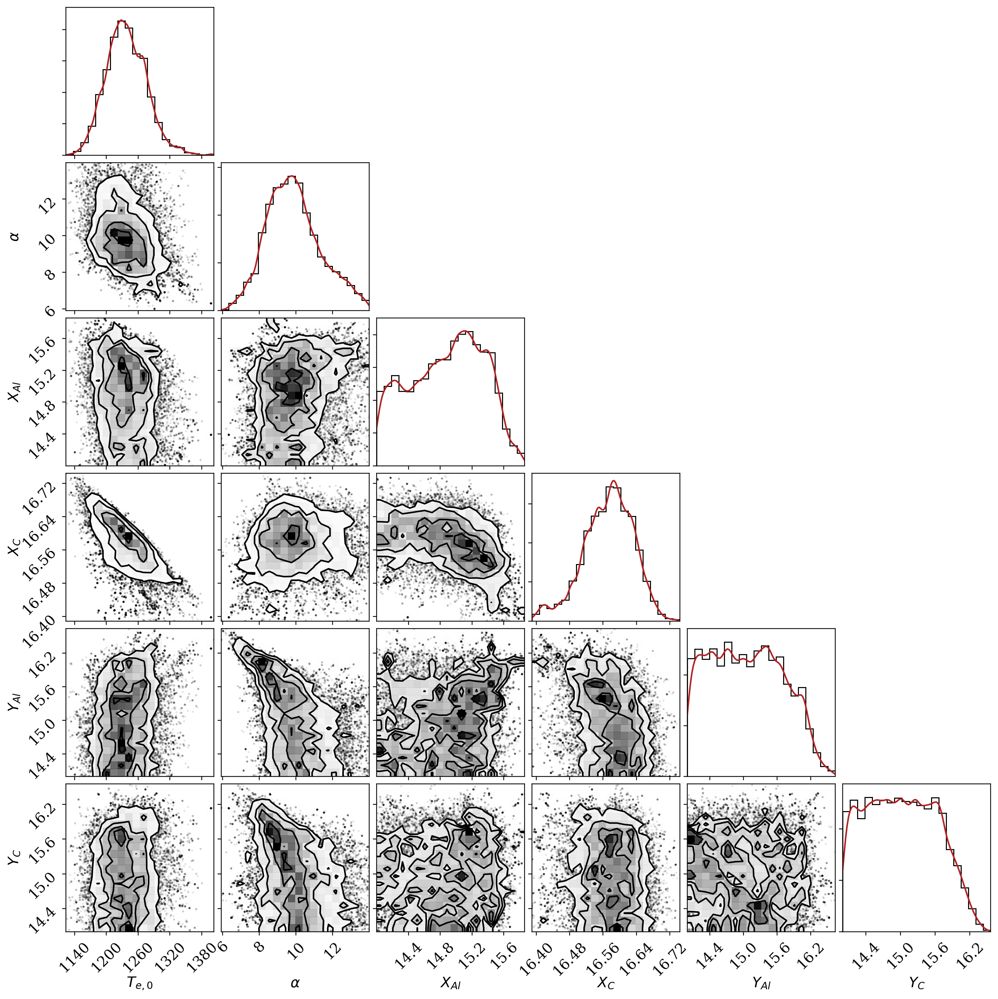

In [328]:
distplot(samples[1], labels=params)

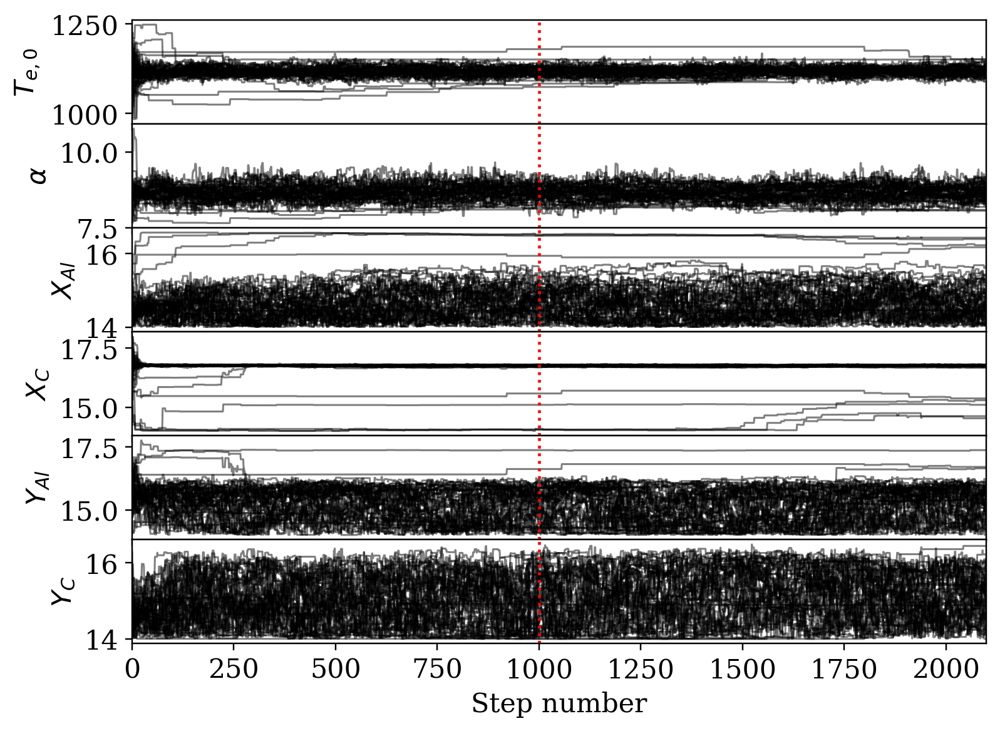

In [329]:
burn_step = 1000
fig, ax = idap.burn_plot(samplers[2].chain, burn_steps[2], nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

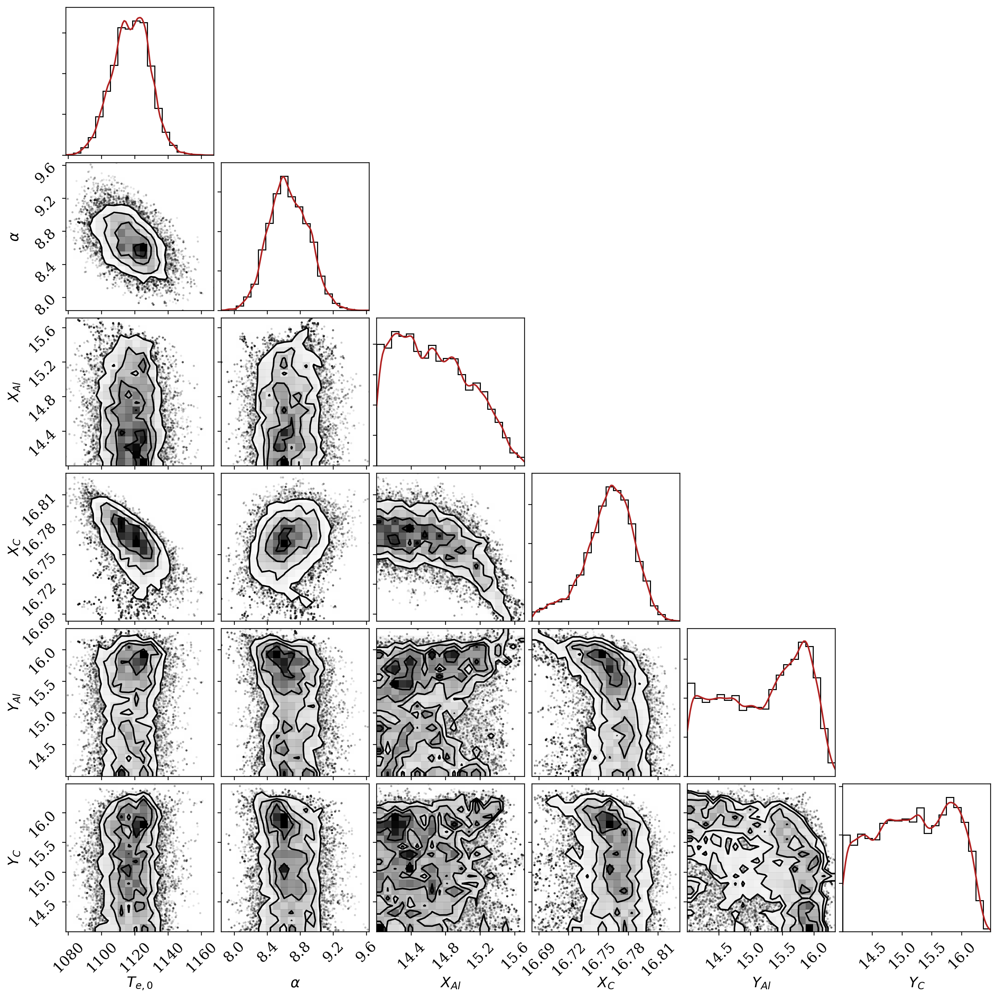

In [330]:
distplot(samples[2], labels=params)

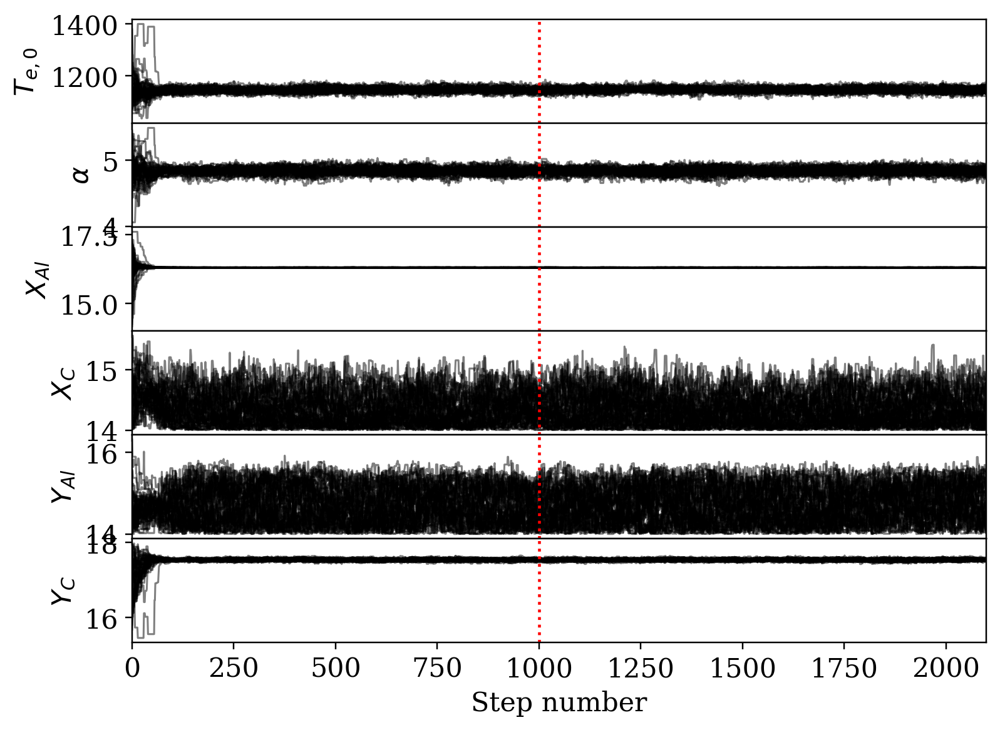

In [331]:
burn_step = 1000
fig, ax = idap.burn_plot(samplers[3].chain, burn_steps[3], nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

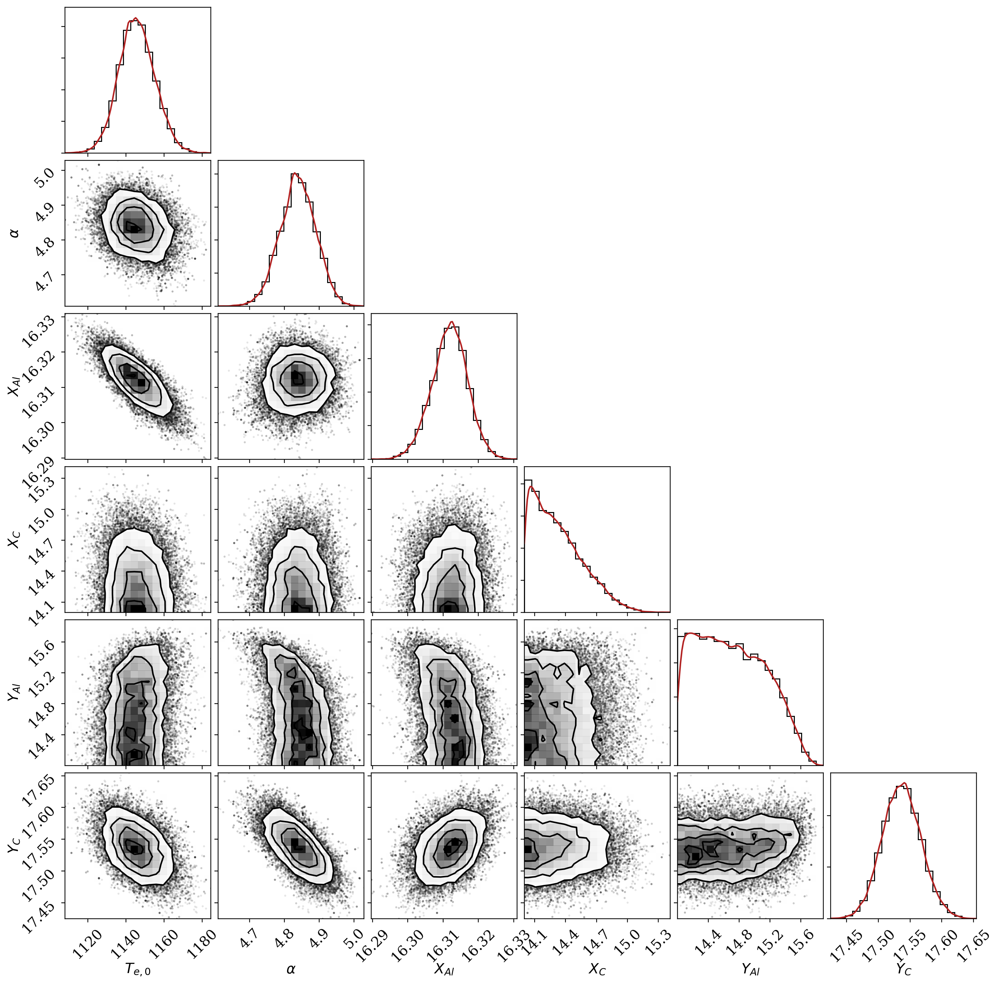

In [332]:
distplot(samples[3], labels=params)

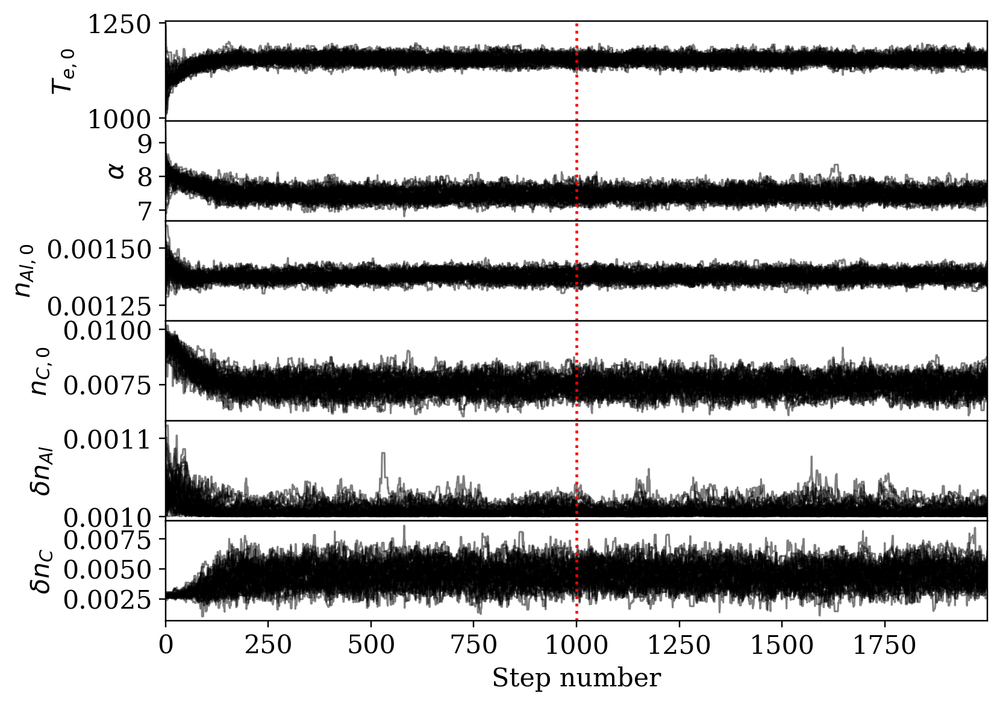

In [297]:
fig, ax = idap.burn_plot(samplers[4].chain, 1000, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

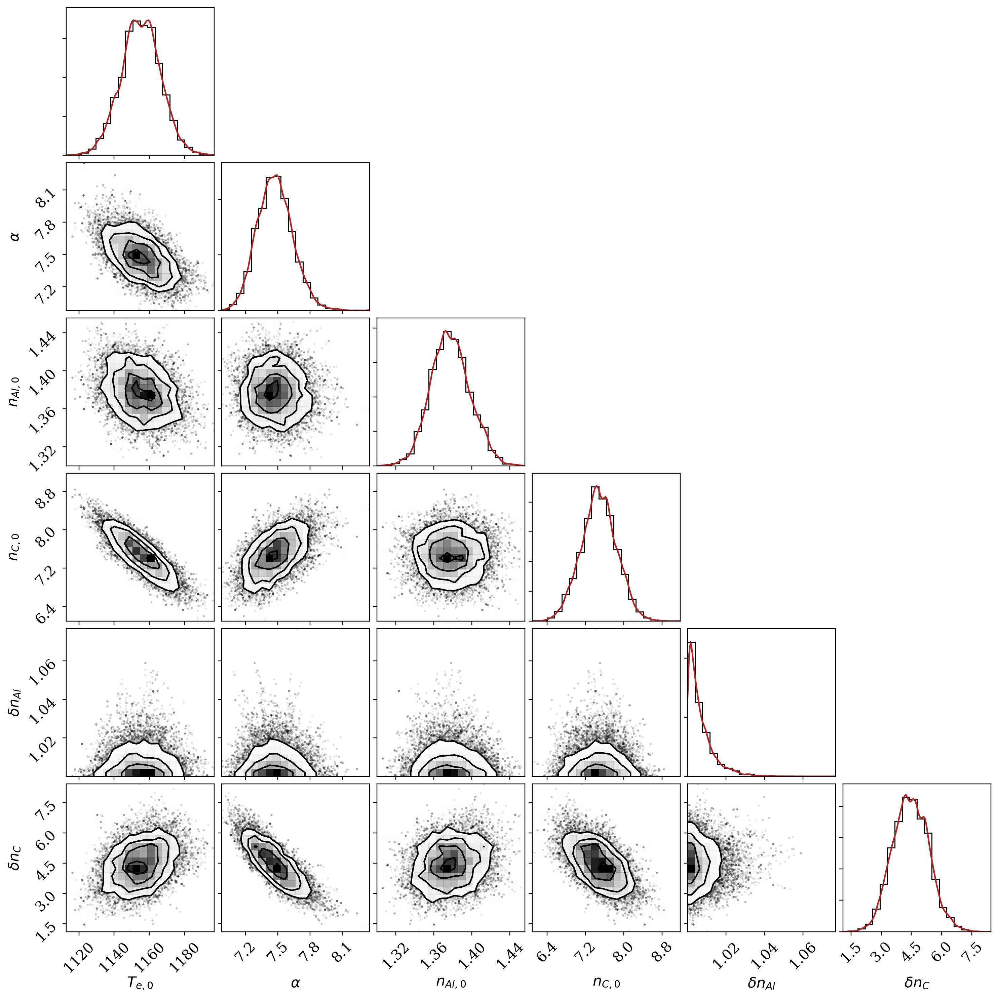

In [298]:
samples[4] = samplers[4].get_chain(discard=1500, flat=True)
vals = np.copy(samples[4])
vals[:, 2:] *= 1e3
distplot(vals, labels=params)

In [299]:
#prof_samples_s1, prof_CIs_s1, rs = get_prof_samples(samples[1], num_samples=5000)
#prof_samples_s2, prof_CIs_s2, rs = get_prof_samples(samples[2], num_samples=5000)
#prof_samples_s3, prof_CIs_s3, rs = get_prof_samples(samples[3], num_samples=5000)
prof_samples_s4, prof_CIs_s4, rs = get_prof_samples(samples[4], num_samples=5000)

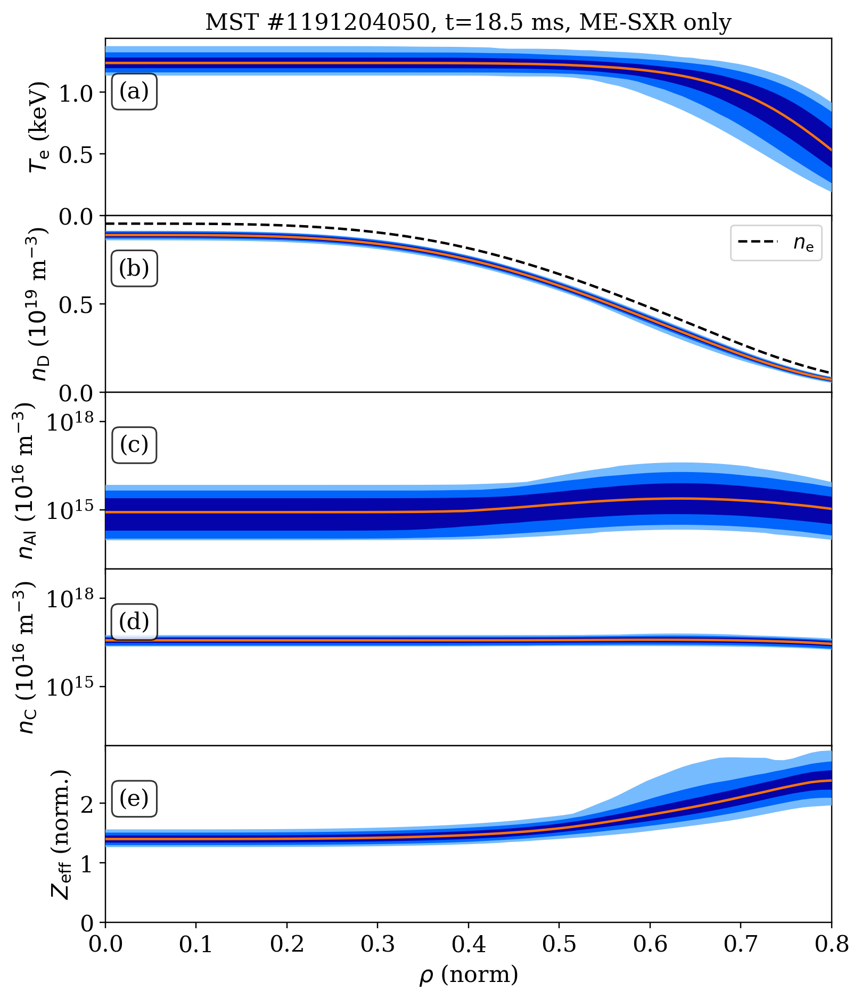

In [335]:
fig, axs = prof_CIs_plot(rs, prof_CIs_s1)
axs[0].set_title('MST #{0:10d}, t={1:.1f} ms, ME-SXR only'.format(shot, time_ms), fontsize=14);

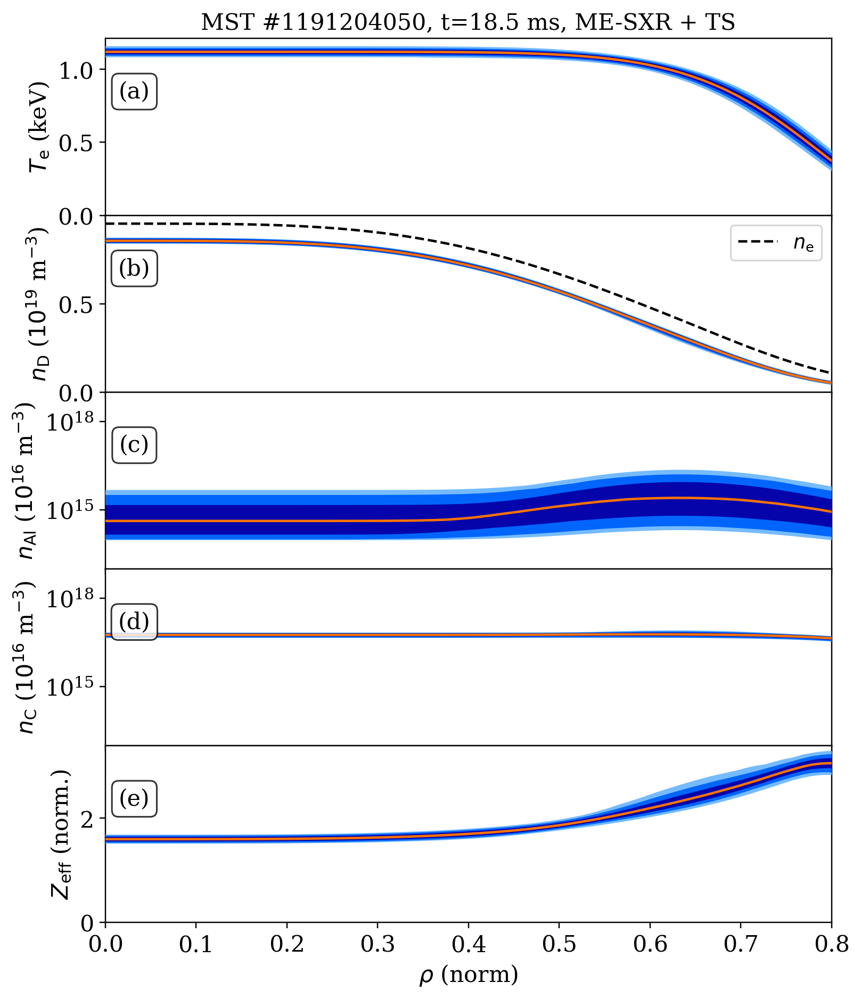

In [336]:
fig, axs = prof_CIs_plot(rs, prof_CIs_s2)
axs[0].set_title('MST #{0:10d}, t={1:.1f} ms, ME-SXR + TS'.format(shot, time_ms), fontsize=14);

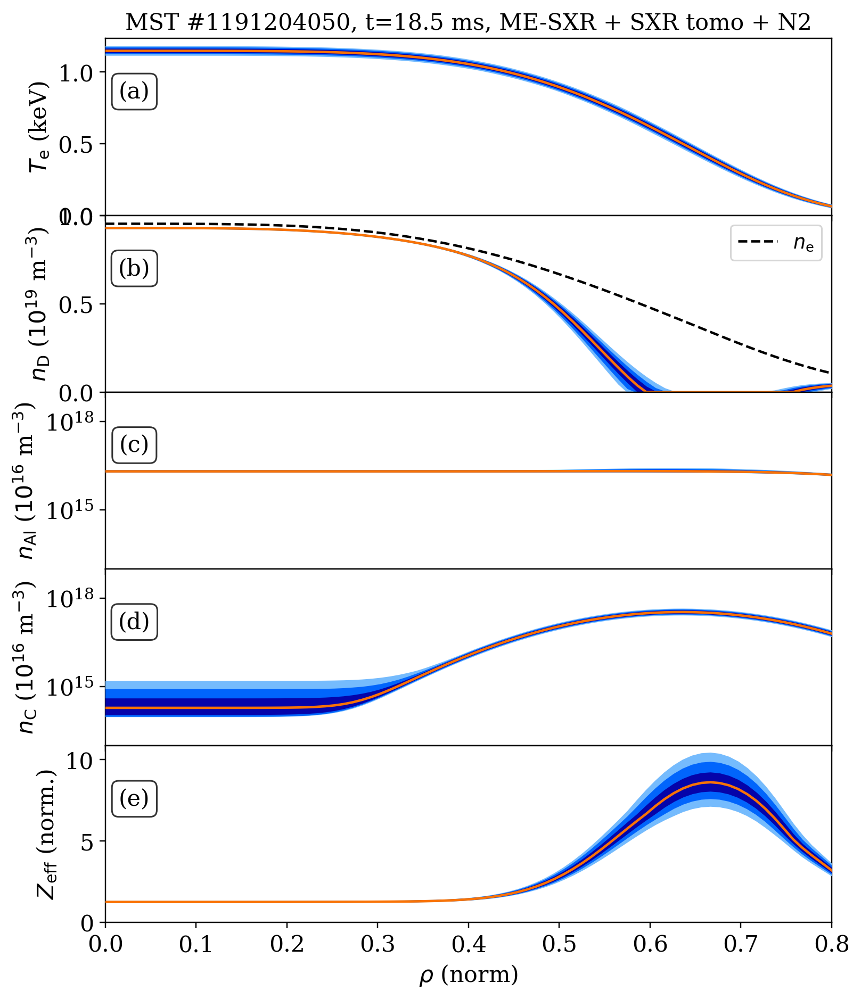

In [337]:
fig, axs = prof_CIs_plot(rs, prof_CIs_s3)
axs[0].set_title('MST #{0:10d}, t={1:.1f} ms, ME-SXR + SXR tomo + N2'.format(shot, time_ms), fontsize=14);

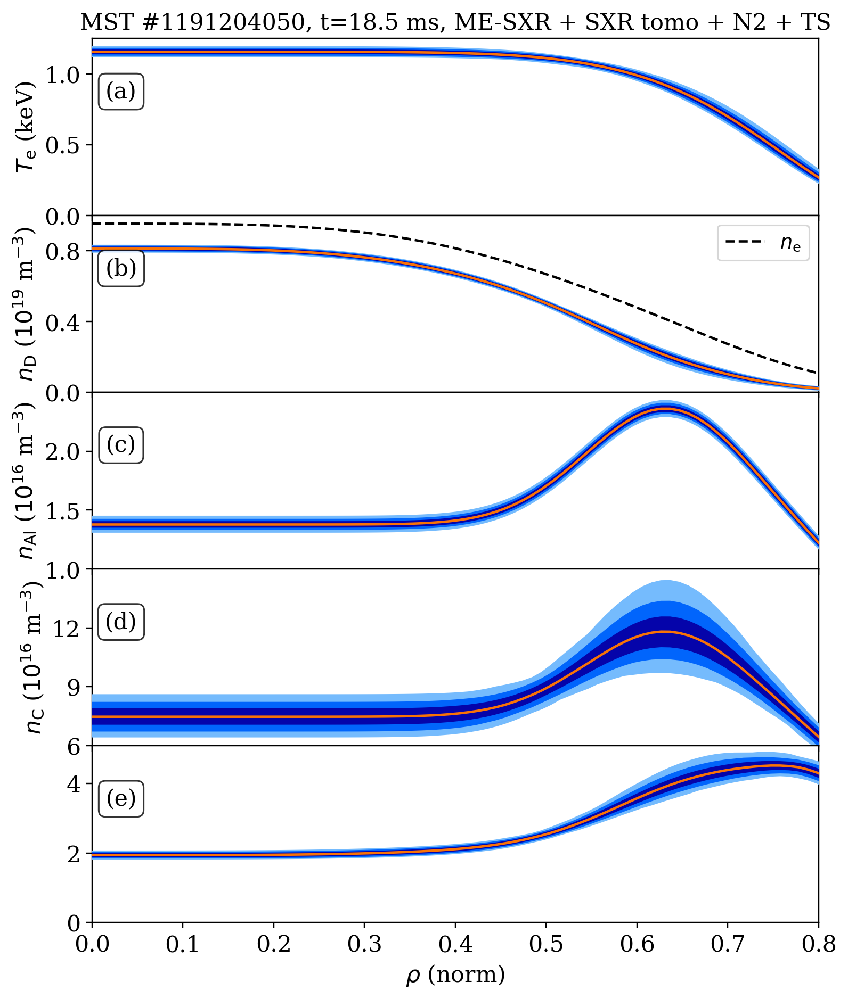

In [402]:
fig, axs = prof_CIs_plot(rs, prof_CIs_s4)
axs[0].set_title('MST #{0:10d}, t={1:.1f} ms, ME-SXR + SXR tomo + N2 + TS'.format(shot, time_ms), fontsize=14)
axs[2].set_ylim([1, 2.5])
axs[3].set_ylim([6, 15]);

In [301]:
nAl0_samples = samples[4][:,2] * 1e3

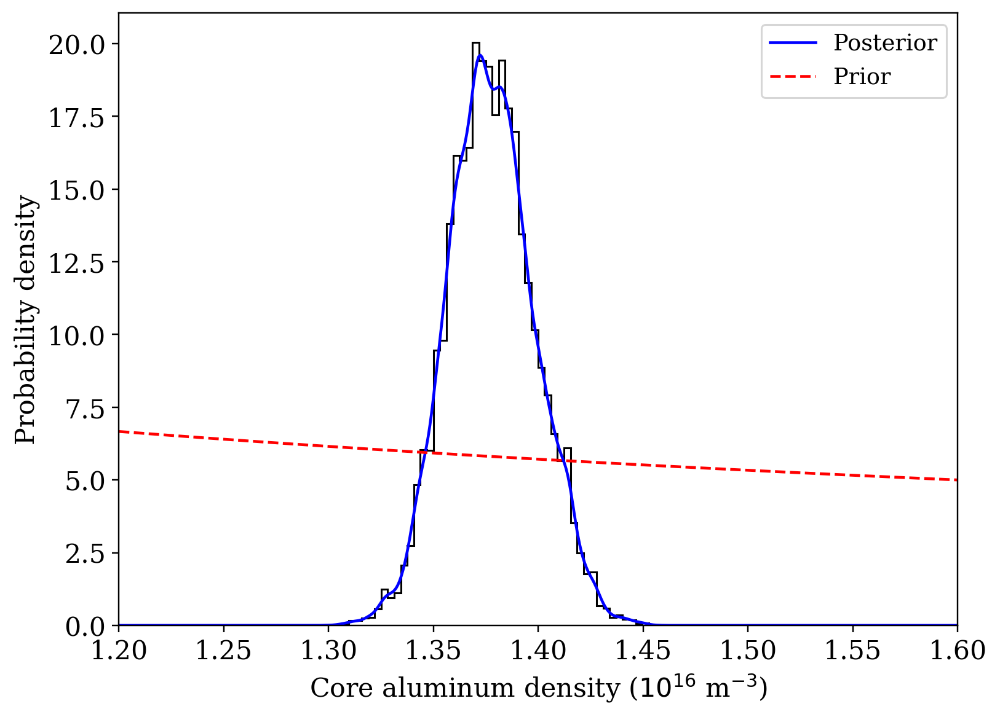

In [305]:
hout = plt.hist(nAl0_samples, bins=50, histtype='step', color='black', density=True)

# Posterior pdf
nAls = np.linspace(1.2, 1.6, num=500)
kde = sp.stats.gaussian_kde(nAl0_samples)
plt.plot(nAls, kde(nAls),  color='blue', label=r'Posterior')

# Prior
plt.plot(nAls, 8/nAls, color='red', linestyle='dashed', label='Prior')

# Make it look good
plt.legend()
plt.xlabel(r'Core aluminum density ($10^{16}$ m$^{-3}$)')
plt.ylabel(r'Probability density')
plt.xlim([nAls[0], nAls[-1]]);

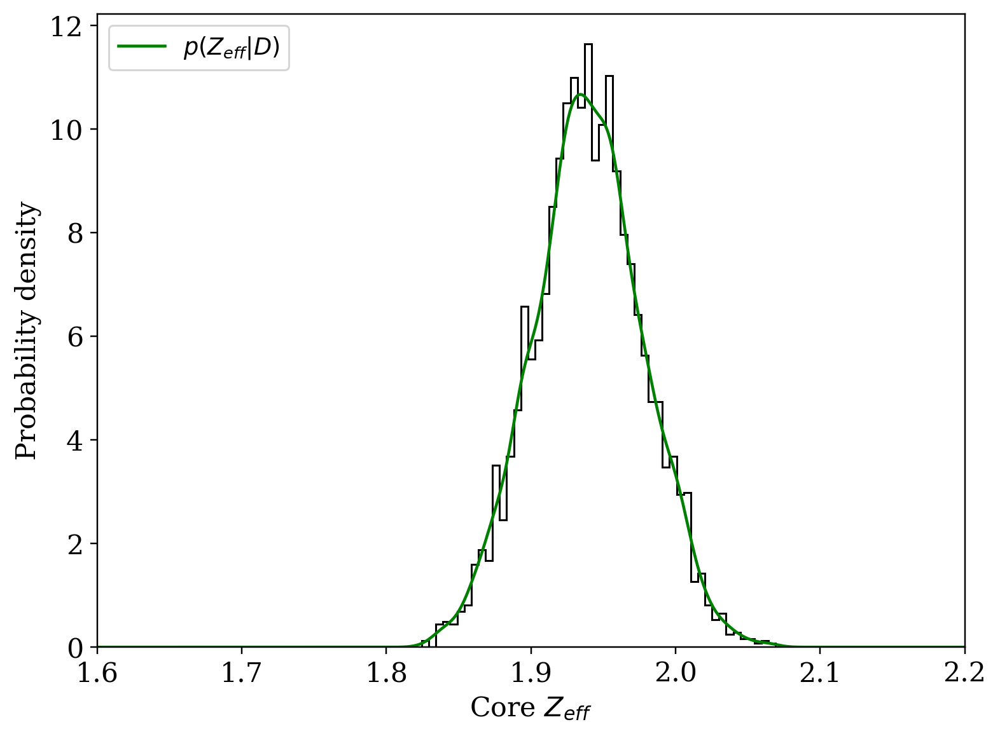

In [306]:
hout = plt.hist(prof_samples_s4.Zeff[:,0], bins=50, histtype='step', color='black', density=True)

# Posterior pdf
zs = np.linspace(1.6, 2.2, num=500)
kde = sp.stats.gaussian_kde(prof_samples_s4.Zeff[:,0])
plt.plot(zs, kde(zs),  color='green', label=r'$p(Z_{eff}|D)$')

# Make it look good
plt.legend()
plt.xlabel(r'Core $Z_{eff}$')
plt.ylabel(r'Probability density')
plt.xlim([zs[0], zs[-1]]);

In [394]:
Zeff_50 = prof_CIs.Zeff['median'][0]
Zeff_hi = prof_CIs.Zeff['1 sigma']['high'][0]
Zeff_lo = prof_CIs.Zeff['1 sigma']['low'][0]

print('<Zeff> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(Zeff_50, Zeff_hi-Zeff_50, Zeff_50-Zeff_lo) )

<Zeff> = 1.910 +0.036/-0.036


In [393]:
Te_50 = prof_CIs.Te['median'][0]
Te_hi = prof_CIs.Te['1 sigma']['high'][0]
Te_lo = prof_CIs.Te['1 sigma']['low'][0]

print('<Te> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(Te_50, Te_hi-Te_50, Te_50-Te_lo) )

Te = 1158.200 +10.504/-11.069


In [397]:
nAl_50 = prof_CIs.nZ['Al']['median'][0] / 1e-3
nAl_hi = prof_CIs.nZ['Al']['1 sigma']['high'][0] / 1e-3
nAl_lo = prof_CIs.nZ['Al']['1 sigma']['low'][0] / 1e-3

print('<nAl> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(nAl_50, nAl_hi-nAl_50, nAl_50-nAl_lo) )

<nAl> = 1.520 +0.020/-0.020


Text(0.5, 0, '$\\rho$ (norm.)')

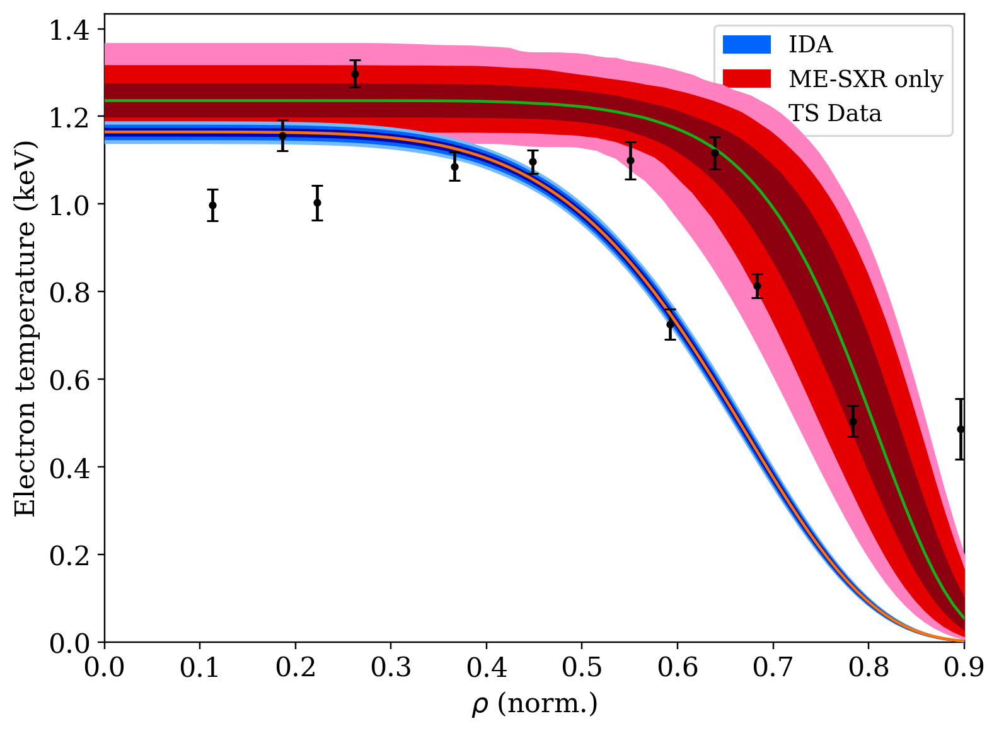

In [339]:
# IDA
plt.plot(rs, prof_CIs_s4.Te['median']/1e3, color='xkcd:orange', zorder=100)
plt.fill_between(rs, prof_CIs_s4.Te['1 sigma']['low']/1e3, prof_CIs_s4.Te['1 sigma']['high']/1e3, color='xkcd:royal blue', zorder=90)
plt.fill_between(rs, prof_CIs_s4.Te['2 sigma']['low']/1e3, prof_CIs_s4.Te['2 sigma']['high']/1e3, color='xkcd:bright blue', zorder=80, label='IDA')
plt.fill_between(rs, prof_CIs_s4.Te['3 sigma']['low']/1e3, prof_CIs_s4.Te['3 sigma']['high']/1e3, color='xkcd:sky blue', zorder=70)

# ME-SXR only
plt.plot(rs, prof_CIs_s1.Te['median']/1e3, color='xkcd:green', zorder=100)
plt.fill_between(rs, prof_CIs_s1.Te['1 sigma']['low']/1e3, prof_CIs_s1.Te['1 sigma']['high']/1e3, color='xkcd:crimson', zorder=60)
plt.fill_between(rs, prof_CIs_s1.Te['2 sigma']['low']/1e3, prof_CIs_s1.Te['2 sigma']['high']/1e3, color='xkcd:red', zorder=50, label='ME-SXR only')
plt.fill_between(rs, prof_CIs_s1.Te['3 sigma']['low']/1e3, prof_CIs_s1.Te['3 sigma']['high']/1e3, color='xkcd:pink', zorder=40)

# Thomson data
plt.errorbar(ts_rhos, y_ts_data/1e3, yerr=y_ts_sigma/1e3, marker='o', color='black', ms=3, capsize=3, linestyle='None', zorder=100, label='TS Data')

# Make it look good
plt.legend()
plt.ylim([0,None])
plt.xlim([0,0.9])
plt.ylabel(r'Electron temperature (keV)')
plt.xlabel(r'$\rho$ (norm.)')

Produce synthetic measurements.

In [342]:
from mst_ida.utilities.structures import AttrDict

def get_posterior_model(samples, num_samples=100):
    """
    """
    y_mesxr_samples = np.zeros([num_samples, len(y_mesxr_data)])
    y_sxt_samples = np.zeros([num_samples, len(y_sxt_data)])
    y_n2_samples = np.zeros([num_samples, len(y_n2_data)])
    
    for ii, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
        y_mesxr_samples[ii,:] = get_model_mesxr(samples[n,:])
        y_sxt_samples[ii,:] = get_model_sxt(samples[n,:])
        y_n2_samples[ii,:] = get_model_n2(samples[n,:])
    
    return AttrDict({
        'mesxr':AttrDict({
            'avg':np.average(y_mesxr_samples, axis=0),
            'std':np.std(y_mesxr_samples, axis=0)
        }),
        'sxt':AttrDict({
            'avg':np.average(y_sxt_samples, axis=0),
            'std':np.std(y_sxt_samples, axis=0)
        }),
        'n2':AttrDict({
            'avg':np.average(y_n2_samples, axis=0),
            'std':np.std(y_n2_samples, axis=0)
        }),
    })

def sample_panel_plot(model, rs, prof_CIs):
    """
    """
    # Combine all the diagnostic signals
    fig, axs = plt.subplots(2, 2, constrained_layout=True, figsize=(10,8))

    # ME-SXR
    ii, = np.where(y_mesxr_labels == 2.5)
    axs[0,0].errorbar(x_mesxr[ii], y_mesxr_data[ii], yerr=y_mesxr_sigma[ii], color=cm.jet(norm(2.5)),
                      marker='o', ms=3, capsize=3, linestyle='none', label='MESXR Data')

    for index,Ec in enumerate(thresholds):
        ii, = np.where(y_mesxr_labels == Ec)
        axs[0,0].errorbar(x_mesxr[ii], y_mesxr_data[ii], yerr=y_mesxr_sigma[ii], marker='o', ms=3, capsize=3,
                          linestyle='none', zorder=100, color=cm.jet(norm(Ec)))
        text(0.94, 0.75-0.06*index, '{0:.1f}'.format(Ec), axs[0,0], color=cm.jet(norm(Ec)), fontsize=12)

    axs[0,0].errorbar(x_mesxr, model.mesxr.avg, yerr=model.mesxr.std, marker='o', ms=3, capsize=3, color='black', linestyle=':', label='Model')
    axs[0,0].set_xlim([0, 479])
    axs[0,0].set_xlabel('Chord index')
    axs[0,0].set_ylabel(r'Counts (ph ms$^{-1}$)')

    # TS
    axs[0,1].errorbar(ts_rhos, y_ts_data, yerr=y_ts_sigma, marker='o', color='red', ms=3, capsize=3, linestyle='None', zorder=100, label='TS Data')
    axs[0,1].plot(rs, prof_CIs.Te['median'], color='xkcd:orange', zorder=100)
    axs[0,1].fill_between(rs, prof_CIs.Te['1 sigma']['low'], prof_CIs.Te['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
    axs[0,1].fill_between(rs, prof_CIs.Te['2 sigma']['low'], prof_CIs.Te['2 sigma']['high'], color='xkcd:bright blue', zorder=80, label='Model')
    axs[0,1].fill_between(rs, prof_CIs.Te['3 sigma']['low'], prof_CIs.Te['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
    
    axs[0,1].set_xlabel(r'$\rho$ (m)')
    axs[0,1].set_ylabel(r'Temperature (eV)')
    axs[0,1].set_xlim([0, 1])
    axs[0,1].yaxis.set_label_position("right")
    axs[0,1].yaxis.tick_right()

    # NICKAl2
    axs[1,0].errorbar(n2_filters, model.n2.avg, yerr=model.n2.std, marker='o', ms=3, capsize=3, linestyle=':', color='black', label='Model')
    axs[1,0].errorbar(n2_filters, y_n2_data, yerr=y_n2_sigma, marker='o', ms=3, capsize=3, linestyle='none', color='red', label='N2 Data')
    axs[1,0].set_xlabel('Filter')
    axs[1,0].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')

    # SXT
    colors = ['red', 'blue']
    ii, = np.where([l.split()[-1] == 'thick' for l in labels])
    axs[1,1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[0], label='SXT Data')

    str_labels = {'thick':r'172 $\mu$m', 'thin':r' 45 $\mu$m'}
    for jj,ft in enumerate(['thick', 'thin']):
        ii, = np.where([l.split()[-1] == ft for l in labels])
        axs[1,1].errorbar(x_sxt[ii], y_sxt_data[ii], yerr=y_sxt_sigma[ii], marker='o', ms=3, capsize=3, linestyle='none', color=colors[jj])
        text(0.1, 0.75-0.06*jj, str_labels[ft], axs[1,1], color=colors[jj], fontsize=12)

    axs[1,1].errorbar(x_sxt, model.sxt.avg, yerr=model.sxt.std, color='black', linestyle=':', marker='o', ms=3, capsize=3, label='Model')
    axs[1,1].set_xlabel('Diode index')
    axs[1,1].set_ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
    axs[1,1].set_xlim([0, 80])

    axs[1,1].yaxis.set_label_position("right")
    axs[1,1].yaxis.tick_right()

    # Make it look better
    for ax in axs.ravel():
        ax.legend()
        ax.set_ylim([0,None])
        
    return fig, axs

In [330]:
model = get_posterior_model(samples[4], num_samples=100)

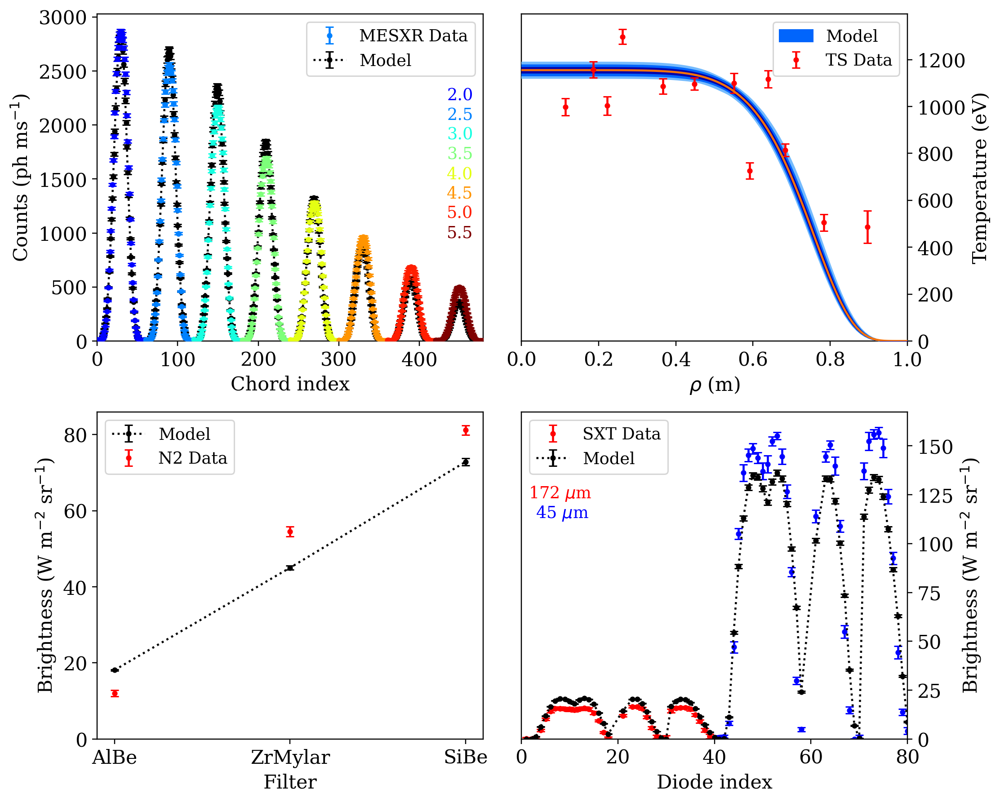

In [343]:
fig, axs = sample_panel_plot(model, rs, prof_CIs_s4)

Compare against the sampler.

## Try it again with a lower bound for $\delta n_{Al}$

Also I'll rewrite the analysis to be more focused so that nothing gets too messy

In [345]:
def ln_prob(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood_s4(theta)
    else:
        return -np.inf

In [344]:
# General emcee settings
n_steps = 2000
nwalkers = 50
ndim = len(x0)

# Reccommended to avoid errors
os.environ["OMP_NUM_THREADS"] = "1"

# Backends for each case
fdir = '/home/pdvanmeter/data/emcee/ppcd/final_IDA/'
filepath = fdir + 'MST_IDA_v4_s4.h5'
backend = emcee.backends.HDFBackend(filepath)
backend.reset(nwalkers, ndim)

In [346]:
pos0 = get_pos0(theta0_MLE_s4)

with Pool(28) as pool:
    sampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob, pool=pool, backend=backend)
    sampler.run_mcmc(pos0, n_steps, progress=True)

100%|██████████| 2000/2000 [3:34:55<00:00,  6.45s/it]  


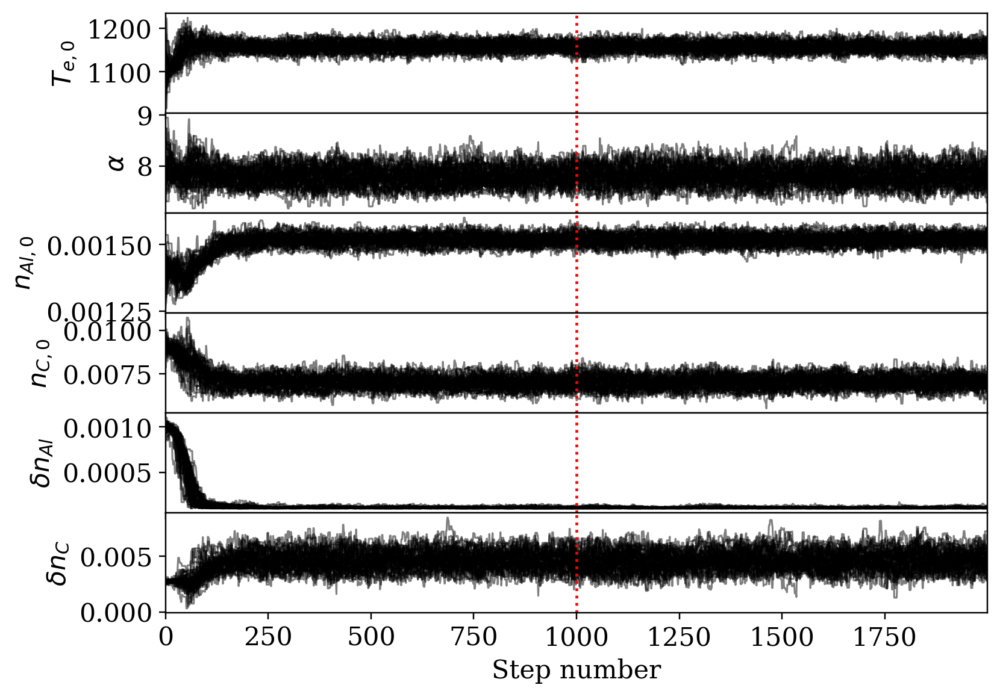

In [347]:
burn_step = 1000
samples = sampler.get_chain(discard=burn_step, flat=True)

fig, ax = idap.burn_plot(sampler.chain, burn_step, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

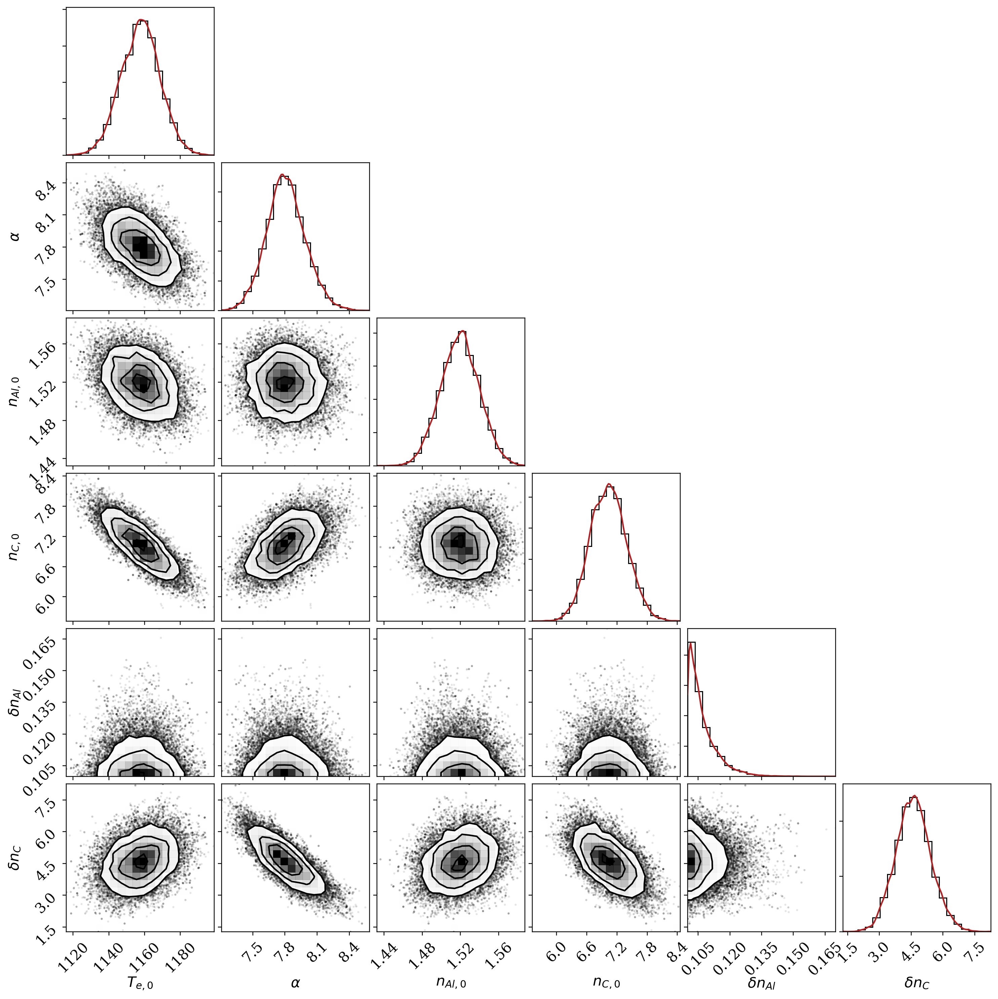

In [350]:
vals = np.copy(samples)
vals[:, 2:] *= 1e3
distplot(vals, labels=params)

In [351]:
prof_samples, prof_CIs, rs = get_prof_samples(samples, num_samples=5000)

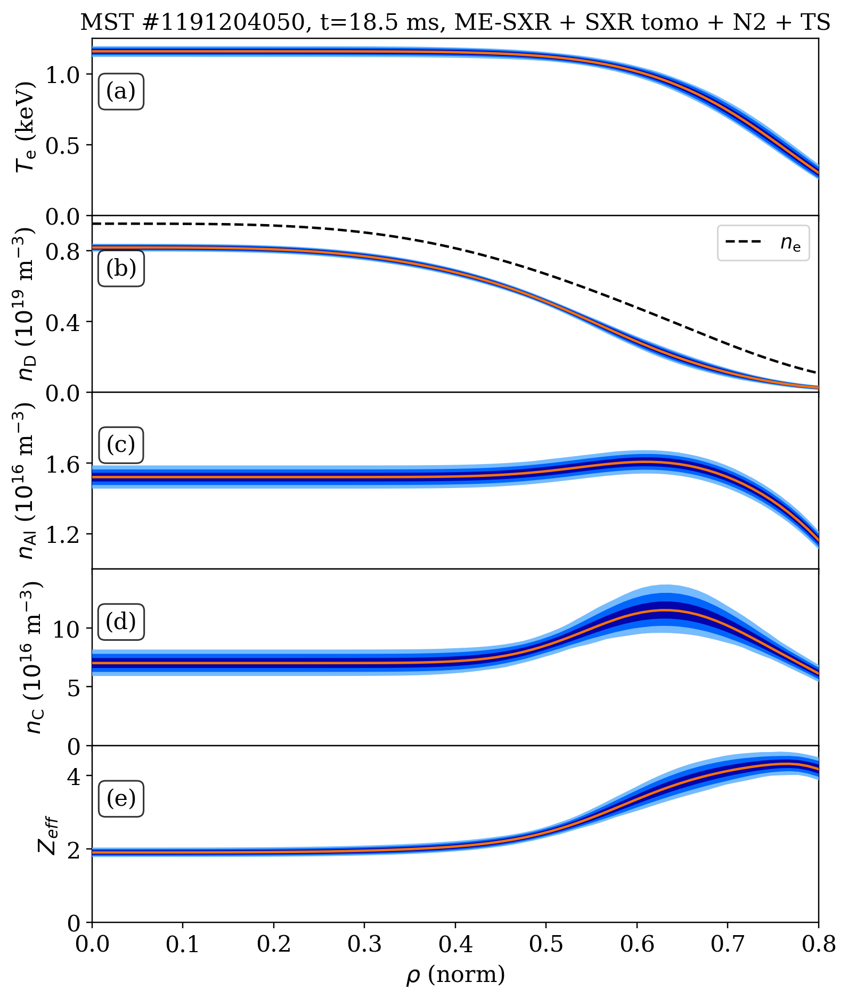

In [526]:
fig, axs = prof_CIs_plot(rs, prof_CIs)
axs[0].set_title('MST #{0:10d}, t={1:.1f} ms, ME-SXR + SXR tomo + N2 + TS'.format(shot, time_ms), fontsize=14)
axs[2].set_ylim([1, 2])
axs[3].set_ylim([0, 15]);

In [354]:
model = get_posterior_model(samples, num_samples=100)

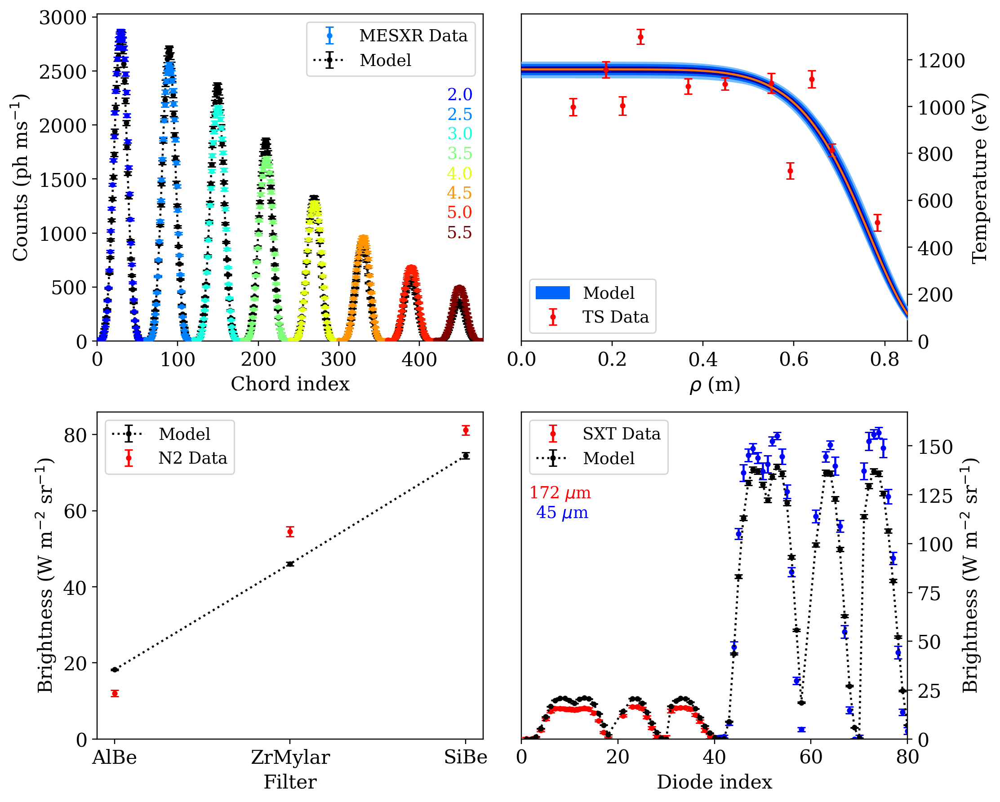

In [432]:
fig, axs = sample_panel_plot(model, rs, prof_CIs)
axs[0,1].set_xlim([0,0.85]);

In [ ]:
Zeff_50 = prof_CIs.Zeff['median'][0]
Zeff_hi = prof_CIs.Zeff['1 sigma']['high'][0]
Zeff_lo = prof_CIs.Zeff['1 sigma']['low'][0]
print('<Zeff> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(Zeff_50, Zeff_hi-Zeff_50, Zeff_50-Zeff_lo) )

Te_50 = prof_CIs.Te['median'][0]
Te_hi = prof_CIs.Te['1 sigma']['high'][0]
Te_lo = prof_CIs.Te['1 sigma']['low'][0]
print('<Te> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(Te_50, Te_hi-Te_50, Te_50-Te_lo) )

nAl_50 = prof_CIs.nZ['Al']['median'][0] / 1e-3
nAl_hi = prof_CIs.nZ['Al']['1 sigma']['high'][0] / 1e-3
nAl_lo = prof_CIs.nZ['Al']['1 sigma']['low'][0] / 1e-3
print('<nAl> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(nAl_50, nAl_hi-nAl_50, nAl_50-nAl_lo) )

## Redo ME-SXR + TS only?

In [419]:
def ln_prob_s2(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood_s2(theta)
    else:
        return -np.inf

In [420]:
# General emcee settings
n_steps = 2000
nwalkers = 50
ndim = len(x0)

# Reccommended to avoid errors
os.environ["OMP_NUM_THREADS"] = "1"

# Backends for each case
fdir = '/home/pdvanmeter/data/emcee/ppcd/final_IDA/'
filepath = fdir + 'MST_IDA_v4_s2.h5'
backend = emcee.backends.HDFBackend(filepath)
backend.reset(nwalkers, ndim)

In [421]:
pos0 = get_pos0(theta0_MLE_s2)

with Pool(28) as pool:
    sampler2 = emcee.EnsembleSampler(nwalkers, ndim, ln_prob_s2, pool=pool, backend=backend)
    sampler2.run_mcmc(pos0, n_steps, progress=True)

100%|██████████| 2000/2000 [2:52:36<00:00,  5.18s/it]  


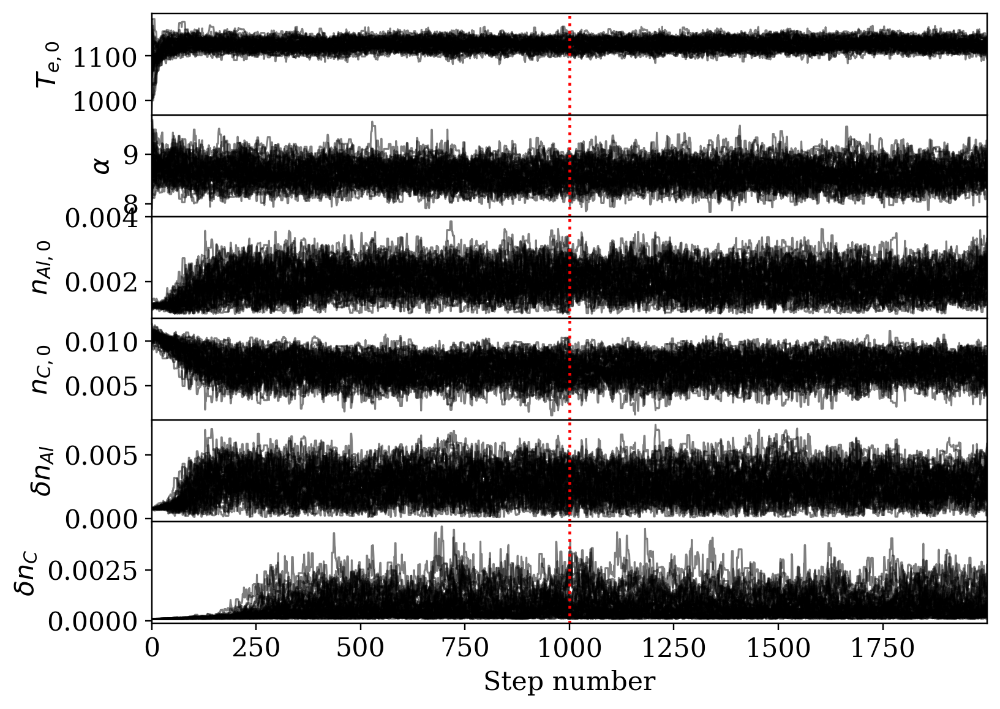

In [422]:
burn_step = 1000
samples2 = sampler2.get_chain(discard=burn_step, flat=True)

fig, ax = idap.burn_plot(sampler2.chain, burn_step, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

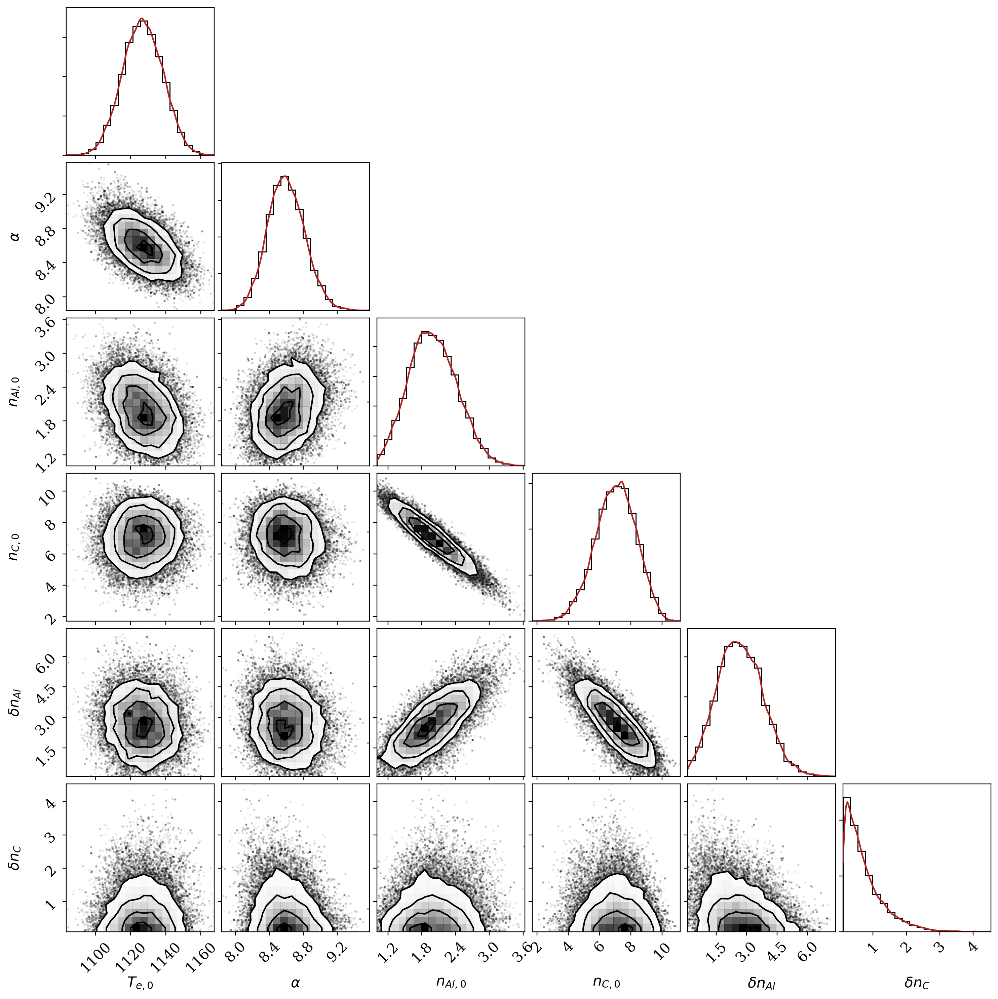

In [461]:
vals = np.copy(samples2)
vals[:, 2:] *= 1e3
distplot(vals, labels=params)

In [423]:
prof_samples2, prof_CIs2, rs = get_prof_samples(samples2, num_samples=5000)

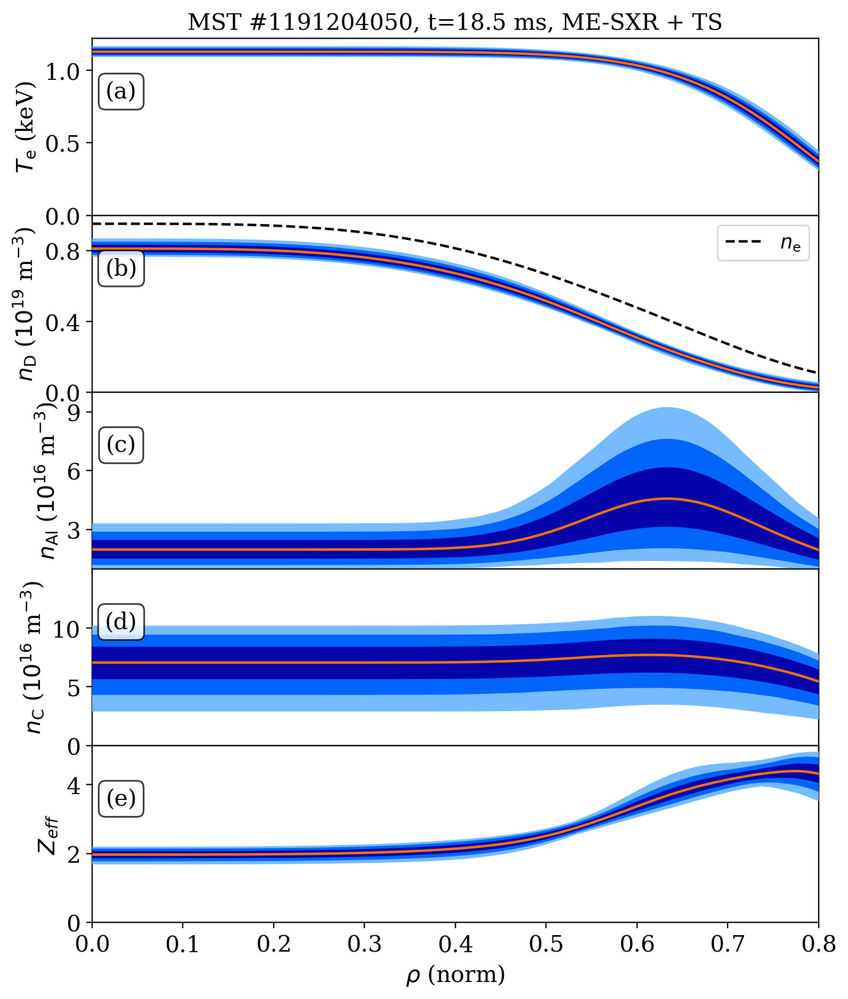

In [525]:
fig, axs = prof_CIs_plot(rs, prof_CIs2)
axs[0].set_title('MST #{0:10d}, t={1:.1f} ms, ME-SXR + TS'.format(shot, time_ms), fontsize=14)
axs[2].set_ylim([1, 10])
axs[3].set_ylim([0, 15]);

In [430]:
model2 = get_posterior_model(samples2, num_samples=100)

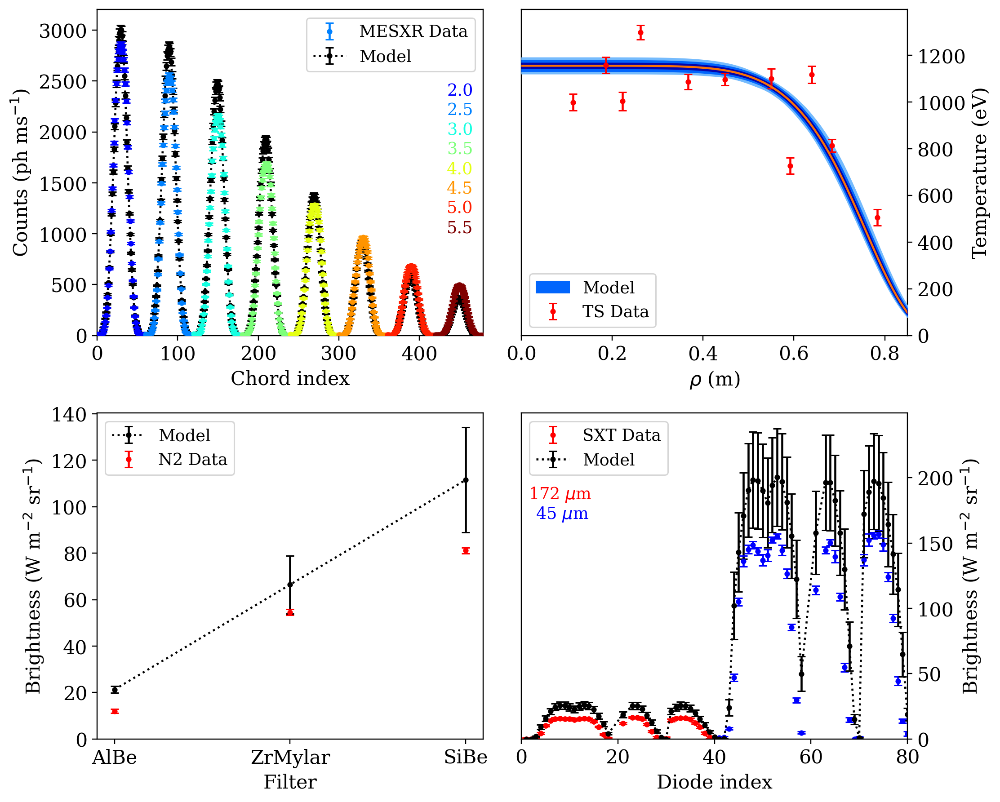

In [431]:
fig, axs = sample_panel_plot(model2, rs, prof_CIs2)
axs[0,1].set_xlim([0,0.85]);

In [523]:
Zeff_50 = prof_CIs2.Zeff['median'][0]
Zeff_hi = prof_CIs2.Zeff['1 sigma']['high'][0]
Zeff_lo = prof_CIs2.Zeff['1 sigma']['low'][0]
print('<Zeff> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(Zeff_50, Zeff_hi-Zeff_50, Zeff_50-Zeff_lo) )

Te_50 = prof_CIs2.Te['median'][0]
Te_hi = prof_CIs2.Te['1 sigma']['high'][0]
Te_lo = prof_CIs2.Te['1 sigma']['low'][0]
print('<Te> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(Te_50, Te_hi-Te_50, Te_50-Te_lo) )

nAl_50 = prof_CIs2.nZ['Al']['median'][0] / 1e-3
nAl_hi = prof_CIs2.nZ['Al']['1 sigma']['high'][0] / 1e-3
nAl_lo = prof_CIs2.nZ['Al']['1 sigma']['low'][0] / 1e-3
print('<nAl> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(nAl_50, nAl_hi-nAl_50, nAl_50-nAl_lo) )

nC_50 = prof_CIs2.nZ['C']['median'][0] / 1e-3
nC_hi = prof_CIs2.nZ['C']['1 sigma']['high'][0] / 1e-3
nC_lo = prof_CIs2.nZ['C']['1 sigma']['low'][0] / 1e-3
print('<nC> = {0:.3f} +{1:.3f}/-{2:.3f}'.format(nC_50, nC_hi-nC_50, nC_50-nC_lo) )

<Zeff> = 1.973 +0.081/-0.084
<Te> = 1126.559 +11.760/-11.219
<nAl> = 1.989 +0.444/-0.418
<nC> = 7.059 +1.272/-1.340


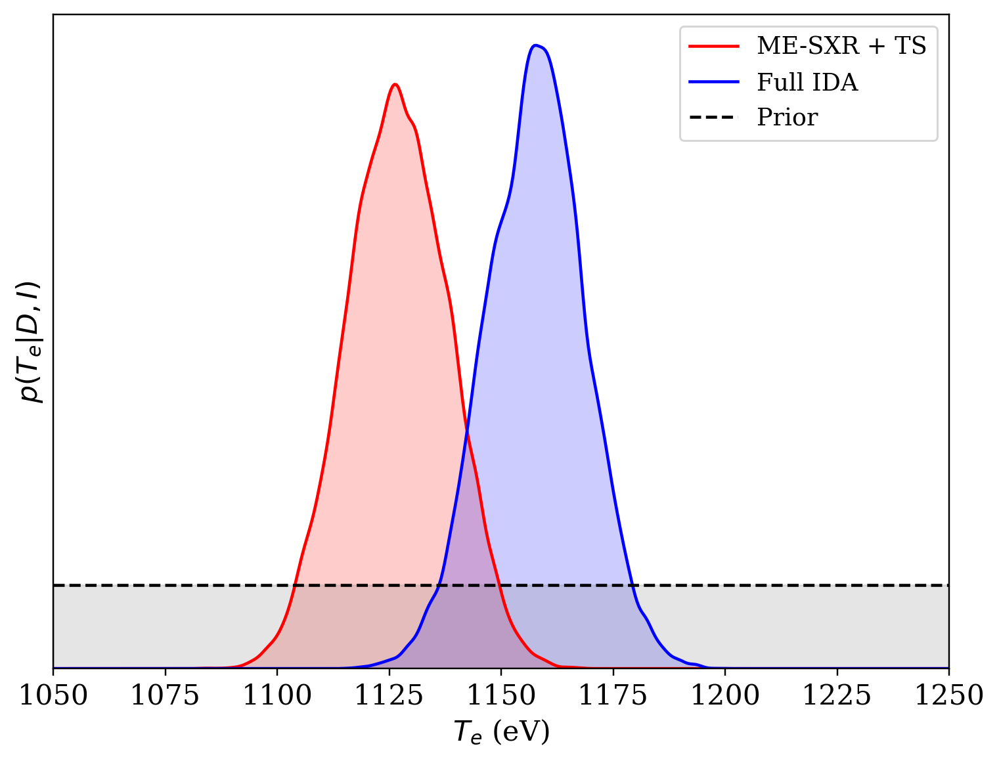

In [498]:
fig, ax = plt.subplots(1,1)

# Estimate the distributions
kde_ida = sp.stats.gaussian_kde(samples[:,0])
kde_ts = sp.stats.gaussian_kde(samples2[:,0])

# Plot KDEs
Te0s = np.linspace(1050, 1250, num = 500)
ax.plot(Te0s, kde_ts(Te0s), color='red', label='ME-SXR + TS')
ax.fill_between(Te0s, kde_ts(Te0s), color='red', alpha=0.2)
ax.plot(Te0s, kde_ida(Te0s), color='blue', label='Full IDA')
ax.fill_between(Te0s, kde_ida(Te0s), color='blue', alpha=0.2)

# Plot prior
Z = np.trapz(np.ones(Te0s.shape), x=Te0s)
prior = np.ones(Te0s.shape)/Z
ax.plot(Te0s, prior, color='black', linestyle='--', label='Prior')
ax.fill_between(Te0s, prior, color='grey', alpha=0.2)

ax.legend()
ax.set_xlim([Te0s[0], Te0s[-1]])
ax.set_ylim([0,None])
ax.set_yticks([])
ax.set_ylabel(r'$p(T_{e}|D,I)$')
ax.set_xlabel(r'$T_{e}$ (eV)');

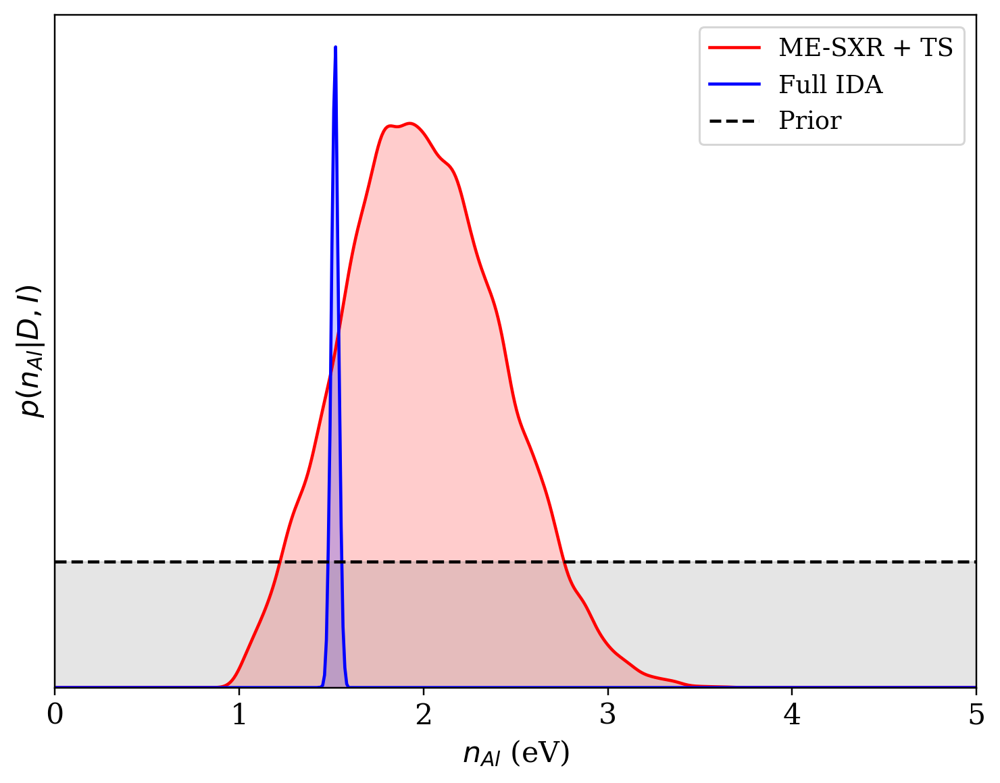

In [496]:
fig, ax = plt.subplots(1,1)

vals_ts = np.copy(samples2[:,2]) / 1e-3
vals_ida = np.copy(samples[:,2]) / 1e-3

# Estimate the distributions
kde_ts = sp.stats.gaussian_kde(vals_ts)
kde_ida = sp.stats.gaussian_kde(vals_ida)

# Plot KDEs
nAl0s = np.linspace(0, 5, num = 500)
ax.plot(nAl0s, kde_ts(nAl0s), color='red', label='ME-SXR + TS')
ax.fill_between(nAl0s, kde_ts(nAl0s), color='red', alpha=0.2)
ax.plot(nAl0s, kde_ida(nAl0s)/20, color='blue', label='Full IDA')
ax.fill_between(nAl0s, kde_ida(nAl0s)/20, color='blue', alpha=0.2)

# Plot prior
Z = np.trapz(np.ones(nAl0s.shape), x=nAl0s)
prior = np.ones(nAl0s.shape)/Z
ax.plot(nAl0s, prior, color='black', linestyle='--', label='Prior')
ax.fill_between(nAl0s, prior, color='grey', alpha=0.2)

ax.legend()
ax.set_xlim([nAl0s[0], nAl0s[-1]])
ax.set_ylim([0,None])
ax.set_yticks([])
ax.set_ylabel(r'$p(n_{Al}|D,I)$')
ax.set_xlabel(r'$n_{Al}$ (eV)');

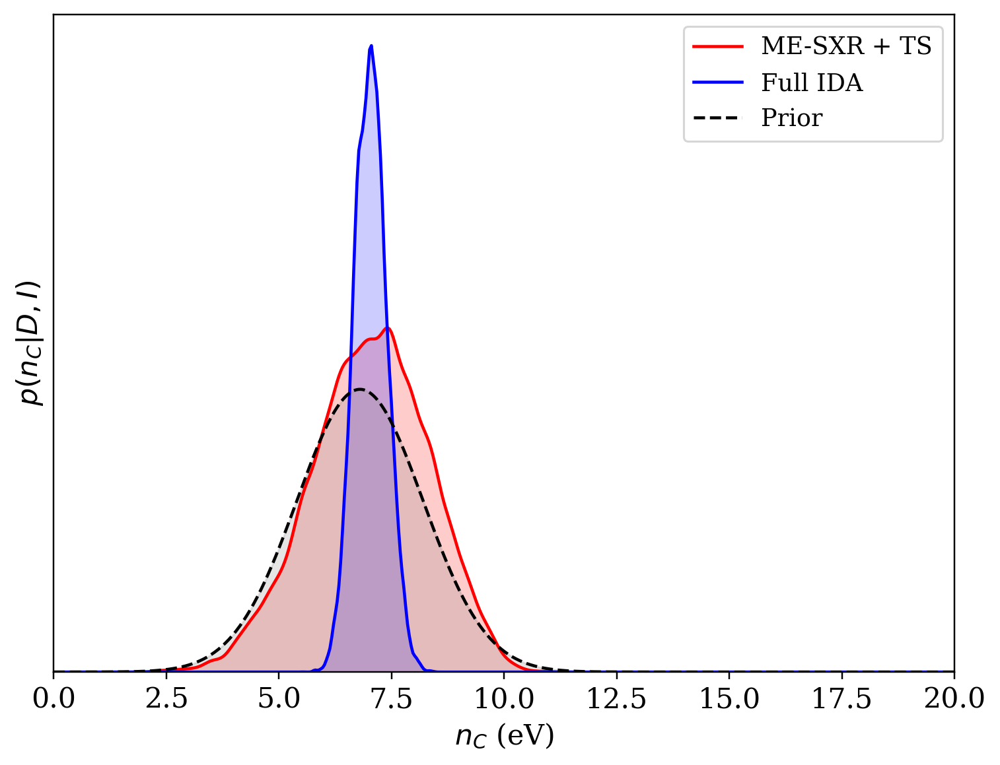

In [503]:
fig, ax = plt.subplots(1,1)

vals_ts = np.copy(samples2[:,3]) / 1e-3
vals_ida = np.copy(samples[:,3]) / 1e-3

# Estimate the distributions
kde_ts = sp.stats.gaussian_kde(vals_ts)
kde_ida = sp.stats.gaussian_kde(vals_ida)

# Plot KDEs
nC0s = np.linspace(0, 20, num = 500)
ax.plot(nC0s, kde_ts(nC0s), color='red', label='ME-SXR + TS')
ax.fill_between(nC0s, kde_ts(nC0s), color='red', alpha=0.2)
ax.plot(nC0s, kde_ida(nC0s)/2, color='blue', label='Full IDA')
ax.fill_between(nC0s, kde_ida(nC0s)/2, color='blue', alpha=0.2)

# Plot prior
prior = np.exp(ln_prior_galante_nC(nC0s*1e-3)) / 4
ax.plot(nC0s, prior, color='black', linestyle='--', label='Prior')
ax.fill_between(nC0s, prior, color='grey', alpha=0.2)

ax.legend()
ax.set_xlim([nC0s[0], nC0s[-1]])
ax.set_ylim([0,None])
ax.set_yticks([])
ax.set_ylabel(r'$p(n_{C}|D,I)$')
ax.set_xlabel(r'$n_{C}$ (eV)');

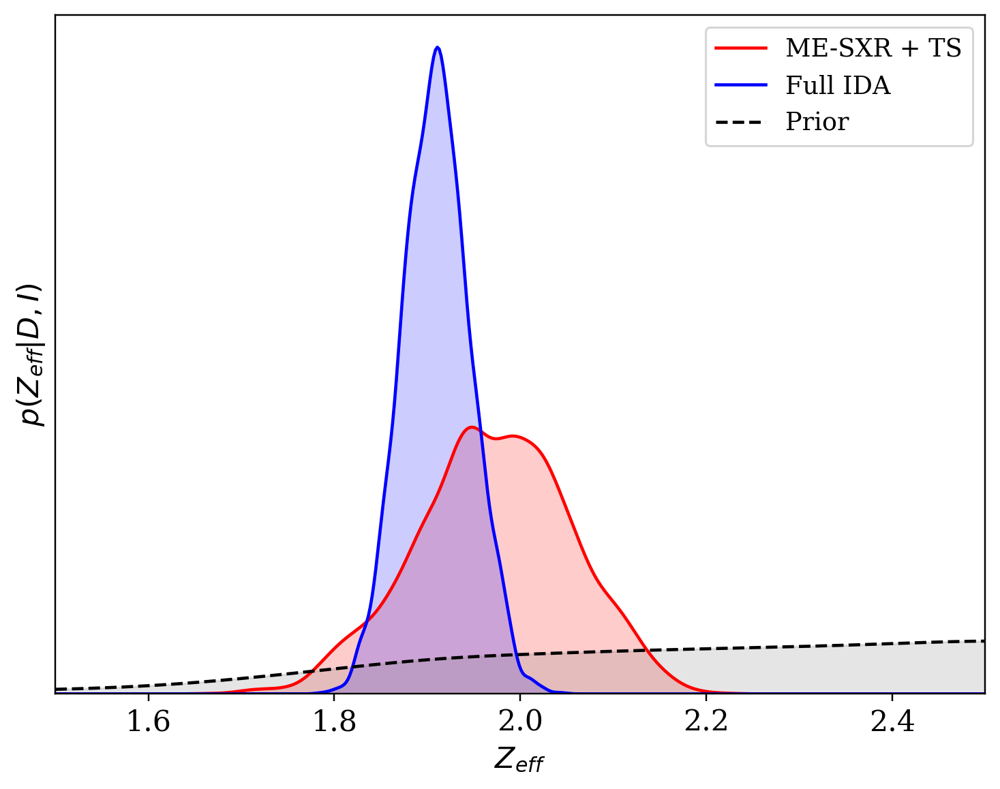

In [505]:
fig, ax = plt.subplots(1,1)

vals_ts = np.copy(prof_samples2.Zeff[:,0])
vals_ida = np.copy(prof_samples.Zeff[:,0])

# Estimate the distributions
kde_ts = sp.stats.gaussian_kde(vals_ts)
kde_ida = sp.stats.gaussian_kde(vals_ida)

# Plot KDEs
Zs = np.linspace(1.5, 2.5, num = 500)
ax.plot(Zs, kde_ts(Zs), color='red', label='ME-SXR + TS')
ax.fill_between(Zs, kde_ts(Zs), color='red', alpha=0.2)
ax.plot(Zs, kde_ida(Zs), color='blue', label='Full IDA')
ax.fill_between(Zs, kde_ida(Zs), color='blue', alpha=0.2)

# Prior
kde_prior = sp.stats.gaussian_kde(prof_samples_s0.Zeff[:,0])
prior = kde_prior(Zs)
ax.plot(Zs, prior, color='black', linestyle='--', label='Prior')
ax.fill_between(Zs, prior, color='grey', alpha=0.2)

ax.legend()
ax.set_xlim([Zs[0], Zs[-1]])
ax.set_ylim([0,None])
ax.set_yticks([])
ax.set_ylabel(r'$p(Z_{eff}|D,I)$')
ax.set_xlabel(r'$Z_{eff}$');

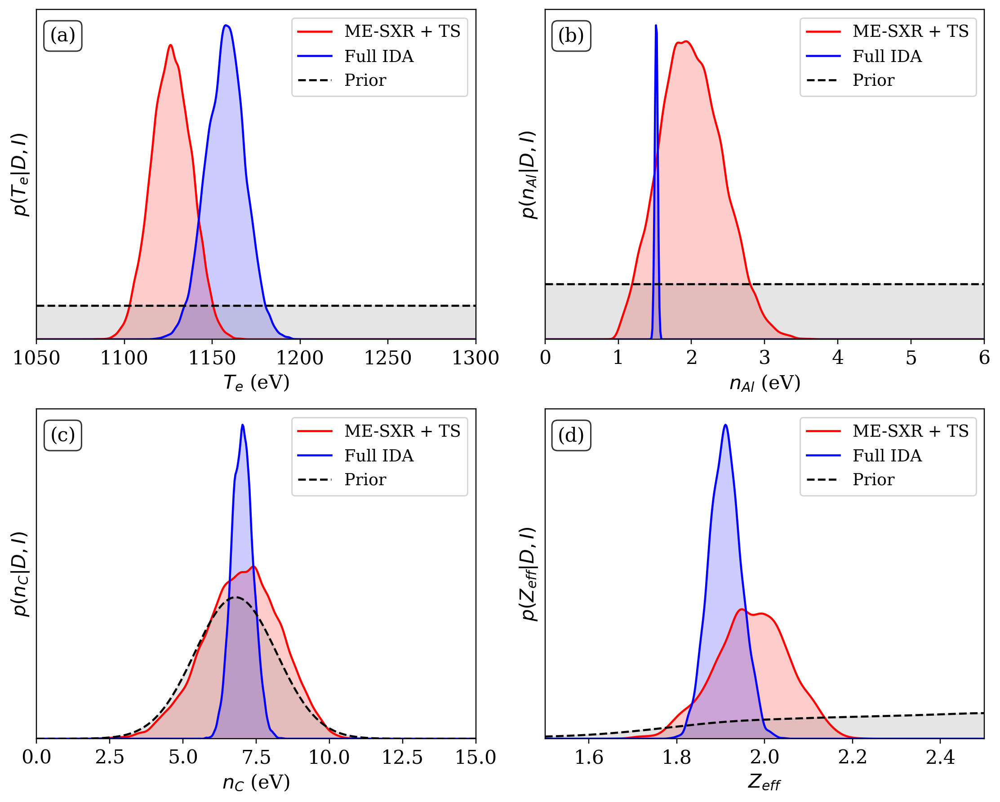

In [521]:
# Combine all the distributions into one comparison
fig, axs = plt.subplots(2, 2, constrained_layout=True, figsize=(10,8))
props = dict(boxstyle='round', facecolor='white', alpha=0.8)

# Parameter ranges
Te0s = np.linspace(1050, 1300, num = 500)
nAl0s = np.linspace(0, 6, num = 500)
nC0s = np.linspace(0, 15, num = 500)
Zs = np.linspace(1.5, 2.5, num = 500)

# Temperature
kde_ida = sp.stats.gaussian_kde(samples[:,0])
kde_ts = sp.stats.gaussian_kde(samples2[:,0])
axs[0,0].plot(Te0s, kde_ts(Te0s), color='red', label='ME-SXR + TS')
axs[0,0].fill_between(Te0s, kde_ts(Te0s), color='red', alpha=0.2)
axs[0,0].plot(Te0s, kde_ida(Te0s), color='blue', label='Full IDA')
axs[0,0].fill_between(Te0s, kde_ida(Te0s), color='blue', alpha=0.2)
Z = np.trapz(np.ones(Te0s.shape), x=Te0s)
prior = np.ones(Te0s.shape)/Z
axs[0,0].plot(Te0s, prior, color='black', linestyle='--', label='Prior')
axs[0,0].fill_between(Te0s, prior, color='grey', alpha=0.2)

# Aluminum
vals_ts = np.copy(samples2[:,2]) / 1e-3
vals_ida = np.copy(samples[:,2]) / 1e-3
kde_ts = sp.stats.gaussian_kde(vals_ts)
kde_ida = sp.stats.gaussian_kde(vals_ida)
axs[0,1].plot(nAl0s, kde_ts(nAl0s), color='red', label='ME-SXR + TS')
axs[0,1].fill_between(nAl0s, kde_ts(nAl0s), color='red', alpha=0.2)
axs[0,1].plot(nAl0s, kde_ida(nAl0s)/20, color='blue', label='Full IDA')
axs[0,1].fill_between(nAl0s, kde_ida(nAl0s)/20, color='blue', alpha=0.2)
Z = np.trapz(np.ones(nAl0s.shape), x=nAl0s)
prior = np.ones(nAl0s.shape)/Z
axs[0,1].plot(nAl0s, prior, color='black', linestyle='--', label='Prior')
axs[0,1].fill_between(nAl0s, prior, color='grey', alpha=0.2)

# Carbon
vals_ts = np.copy(samples2[:,3]) / 1e-3
vals_ida = np.copy(samples[:,3]) / 1e-3
kde_ts = sp.stats.gaussian_kde(vals_ts)
kde_ida = sp.stats.gaussian_kde(vals_ida)
axs[1,0].plot(nC0s, kde_ts(nC0s), color='red', label='ME-SXR + TS')
axs[1,0].fill_between(nC0s, kde_ts(nC0s), color='red', alpha=0.2)
axs[1,0].plot(nC0s, kde_ida(nC0s)/2, color='blue', label='Full IDA')
axs[1,0].fill_between(nC0s, kde_ida(nC0s)/2, color='blue', alpha=0.2)
prior = np.exp(ln_prior_galante_nC(nC0s*1e-3)) / 4
axs[1,0].plot(nC0s, prior, color='black', linestyle='--', label='Prior')
axs[1,0].fill_between(nC0s, prior, color='grey', alpha=0.2)

# Zeff
vals_ts = np.copy(prof_samples2.Zeff[:,0])
vals_ida = np.copy(prof_samples.Zeff[:,0])
kde_ts = sp.stats.gaussian_kde(vals_ts)
kde_ida = sp.stats.gaussian_kde(vals_ida)
axs[1,1].plot(Zs, kde_ts(Zs), color='red', label='ME-SXR + TS')
axs[1,1].fill_between(Zs, kde_ts(Zs), color='red', alpha=0.2)
axs[1,1].plot(Zs, kde_ida(Zs), color='blue', label='Full IDA')
axs[1,1].fill_between(Zs, kde_ida(Zs), color='blue', alpha=0.2)
kde_prior = sp.stats.gaussian_kde(prof_samples_s0.Zeff[:,0])
prior = kde_prior(Zs)
axs[1,1].plot(Zs, prior, color='black', linestyle='--', label='Prior')
axs[1,1].fill_between(Zs, prior, color='grey', alpha=0.2)

# Limits and labels
#axs[0,0].legend()
axs[0,0].set_xlim([Te0s[0], Te0s[-1]])
axs[0,0].set_ylabel(r'$p(T_{e}|D,I)$')
axs[0,0].set_xlabel(r'$T_{e}$ (eV)')

axs[0,1].set_xlim([nAl0s[0], nAl0s[-1]])
axs[0,1].set_ylabel(r'$p(n_{Al}|D,I)$')
axs[0,1].set_xlabel(r'$n_{Al}$ (eV)')

axs[1,0].set_xlim([nC0s[0], nC0s[-1]])
axs[1,0].set_ylabel(r'$p(n_{C}|D,I)$')
axs[1,0].set_xlabel(r'$n_{C}$ (eV)')

axs[1,1].set_xlim([Zs[0], Zs[-1]])
axs[1,1].set_ylabel(r'$p(Z_{eff}|D,I)$')
axs[1,1].set_xlabel(r'$Z_{eff}$')

# Shared pieces
for ax in axs.ravel():
    ax.legend()
    ax.set_ylim([0,None])
    ax.set_yticks([])
    
for ax,alpha in zip(axs.ravel(), ['a','b','c','d']):
    text(0.06, 0.92, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props, zorder=100)